In [ ]:
!pip install nilearn

from sklearn.decomposition import FastICA
from sklearn.feature_selection import f_classif
import numpy as np
import os
from nilearn import image  # Import for image manipulation and mask creation
import nibabel as nib  # Import for loading fMRI data (.nii format)


def load_fmri_data(fmri_data_path):
    # Load the preprocessed fMRI data
    fmri_img = nib.load(fmri_data_path)
    return fmri_img


def load_neurosynth_dmn_map(dmn_map_path):
    # Load the DMN activation map
    dmn_map = nib.load(dmn_map_path)
    return dmn_map


def create_threshold_mask(fmri_img, dmn_map_path, threshold):
    # Load the DMN activation map
    dmn_map = nib.load(dmn_map_path)

    # Resample the DMN activation map to match the dimensions of the fMRI data
    dmn_map_resampled = image.resample_to_img(dmn_map, fmri_img, interpolation='nearest')

    # Create a mask using thresholding
    mask_data = dmn_map_resampled.get_fdata() > threshold
    mask_data = mask_data.astype(bool)  # Convert mask_data to boolean type

    mask_img = image.new_img_like(dmn_map_resampled, mask_data)
    return mask_img

# Example function for using an anatomical mask
def load_anatomical_mask(mask_path):

    # Check if mask_path is a valid file path
    if os.path.isfile(mask_path):
        # Load the mask from the specified file path
        mask_img = nib.load(mask_path)
    else:
        # Try fetching the mask from the Nilearn dataset using the keyword
        try:
            mask_img = datasets.fetch_atlas_harvard_oxford(regions=[mask_path], labels=True).maps
        except Exception as e:
            raise ValueError(f"Invalid mask path or keyword: {mask_path}. Error: {e}")

    return mask_img


from nilearn.connectome import ConnectivityMeasure
import numpy as np
from nilearn.input_data import NiftiMasker



def seed_based_functional_connectivity(fmri_img, mask, output_filename):

    # Extract time series from the mask
    masker = NiftiMasker(mask_img=mask)
    seed_time_series = masker.fit_transform(fmri_img)

    # Ensure the seed_time_series is 2D
    if len(seed_time_series.shape) == 1:
        seed_time_series = np.expand_dims(seed_time_series, axis=0)

    # Create a connectivity object
    connectivity = ConnectivityMeasure(kind='correlation')

    # Fit the connectivity model
    connectivity.fit([seed_time_series])

    # Calculate functional connectivity coefficients
    correlation_map = connectivity.transform([seed_time_series])

    # Convert correlation_map to Nifti image
    correlation_map_img = nib.Nifti1Image(correlation_map[0], affine=fmri_img.affine)

    # Save the functional connectivity map as a Nifti image
    nib.save(correlation_map_img, output_filename)

    print(f"Functional connectivity map saved to: {output_filename}")



def main():

    fmri_data_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJECT'
    dmn_map_path = '/content/drive/MyDrive/Neurosynth/network dmn_association-test_z_FDR_0.01.nii'
    mask_creation_args = {'dmn_map_path': dmn_map_path, 'threshold': 0.5}
    output_dir = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

    # Loop through each fMRI data file in the folder
    for filename in os.listdir(fmri_data_folder):
        if filename.endswith('.nii'):
            fmri_file_path = os.path.join(fmri_data_folder, filename)
            output_filename = os.path.join(output_dir, f"{filename}_functional_connectivity.nii")

            # Load the fMRI data and DMN map
            fmri_img = load_fmri_data(fmri_file_path)

            # Create the mask using the chosen function and arguments
            mask = create_threshold_mask(fmri_img, **mask_creation_args)

            # Perform seed-based functional connectivity analysis
            seed_based_functional_connectivity(fmri_img, mask, output_filename)

    print("Functional connectivity analysis completed.")

# Call the main function if the script is run directly
if __name__ == "__main__":
    main()


Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1004_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1005_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1006_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1007_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1008_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1009_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content

removing all extra signals- functional connectivity

In [ ]:
!pip install nilearn

from nilearn.connectome import ConnectivityMeasure
from nilearn.input_data import NiftiMasker
from nilearn import datasets, image
import numpy as np
import os
import nibabel as nib

def load_fmri_data(fmri_data_path):
    fmri_img = nib.load(fmri_data_path)
    return fmri_img

def create_threshold_mask(fmri_img, dmn_map_path, threshold):

    dmn_map = nib.load(dmn_map_path)
    dmn_map_resampled = image.resample_to_img(dmn_map, fmri_img, interpolation='nearest')
    mask_data = dmn_map_resampled.get_fdata() > threshold
    mask_data = mask_data.astype(bool)
    mask_img = image.new_img_like(dmn_map_resampled, mask_data)
    return mask_img

def average_signals(fmri_img):
    masker = NiftiMasker(smoothing_fwhm=6, standardize=True)
    masker.fit(fmri_img)
    avg_signals = masker.transform(fmri_img)
    avg_fmri_img = masker.inverse_transform(avg_signals)
    return avg_fmri_img

def seed_based_functional_connectivity(fmri_img, mask, output_filename):
    masker = NiftiMasker(mask_img=mask)
    seed_time_series = masker.fit_transform(fmri_img)
    if len(seed_time_series.shape) == 1:
        seed_time_series = np.expand_dims(seed_time_series, axis=0)
    connectivity = ConnectivityMeasure(kind='correlation')
    connectivity.fit([seed_time_series])
    correlation_map = connectivity.transform([seed_time_series])
    correlation_map_img = nib.Nifti1Image(correlation_map[0], affine=fmri_img.affine)
    nib.save(correlation_map_img, output_filename)
    print(f"Functional connectivity map saved to: {output_filename}")

def main():

    fmri_data_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJECT'
    dmn_map_path = '/content/drive/MyDrive/Neurosynth/network dmn_association-test_z_FDR_0.01.nii'
    mask_creation_args = {'dmn_map_path': dmn_map_path, 'threshold': 0.5}
    output_dir = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

    for filename in os.listdir(fmri_data_folder):
        if filename.endswith('.nii'):
            fmri_file_path = os.path.join(fmri_data_folder, filename)
            output_filename = os.path.join(output_dir, f"{filename}_functional_connectivity.nii")

            fmri_img = load_fmri_data(fmri_file_path)
            avg_fmri_img = average_signals(fmri_img)
            mask = create_threshold_mask(avg_fmri_img, **mask_creation_args)

            seed_based_functional_connectivity(avg_fmri_img, mask, output_filename)

    print("Functional connectivity analysis completed.")

if __name__ == "__main__":
    main()


Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1004_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1005_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1006_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1007_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1008_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1009_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii
Functional connectivity map saved to: /content

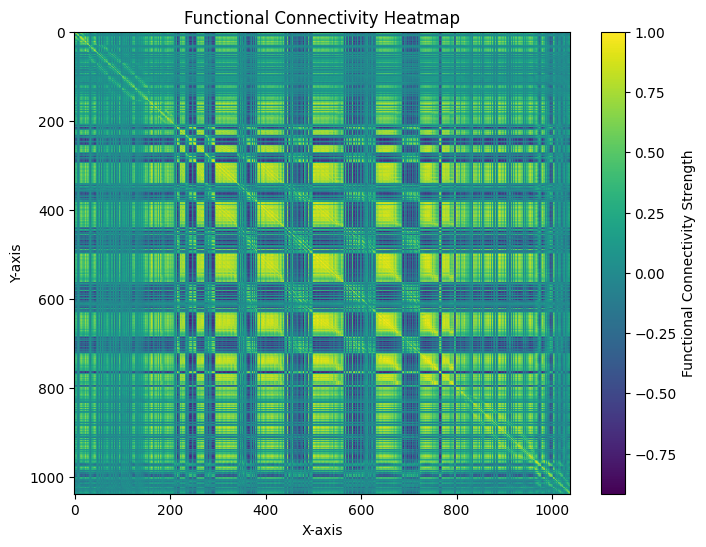

In [ ]:
import matplotlib.pyplot as plt
from nilearn.image import load_img

# Define file path
functional_map_path = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1004_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii'

# Load the functional connectivity map
connectivity_map = load_img(functional_map_path)

# Extract data from the map
connectivity_data = connectivity_map.get_fdata()

# Create the heatmap using Matplotlib
plt.figure(figsize=(8, 6))
plt.imshow(connectivity_data, cmap='viridis', aspect='auto')

# Add colorbar
plt.colorbar(label='Functional Connectivity Strength')

# Add labels and title
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.title('Functional Connectivity Heatmap')

# Display the plot
plt.show()


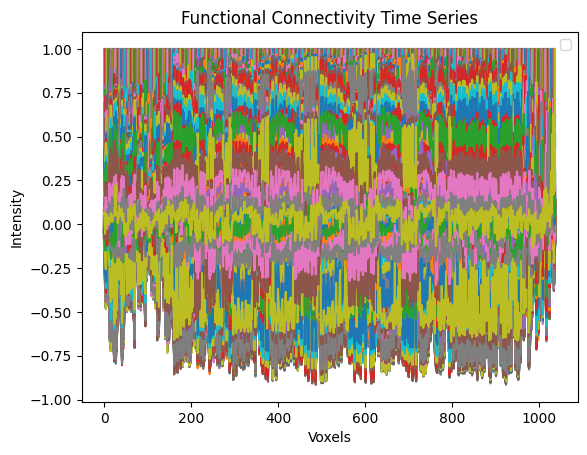

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Load the 4D Nifti image
fmri_img = image.load_img('/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS/sub-1004_task-rest_dir-AP_run-01_bold.nii_functional_connectivity.nii')

# Get the data as a numpy array
data = fmri_img.get_fdata()

# Plot each volume as a time series
fig, ax = plt.subplots()
for i in range(data.shape[-1]):
    ax.plot(data[..., i])
ax.legend()
ax.set_title('Functional Connectivity Time Series')
ax.set_xlabel('Voxels')
ax.set_ylabel('Intensity')
plt.show()


Statistical testing on functional connectivity maps- t-test and permutaion test

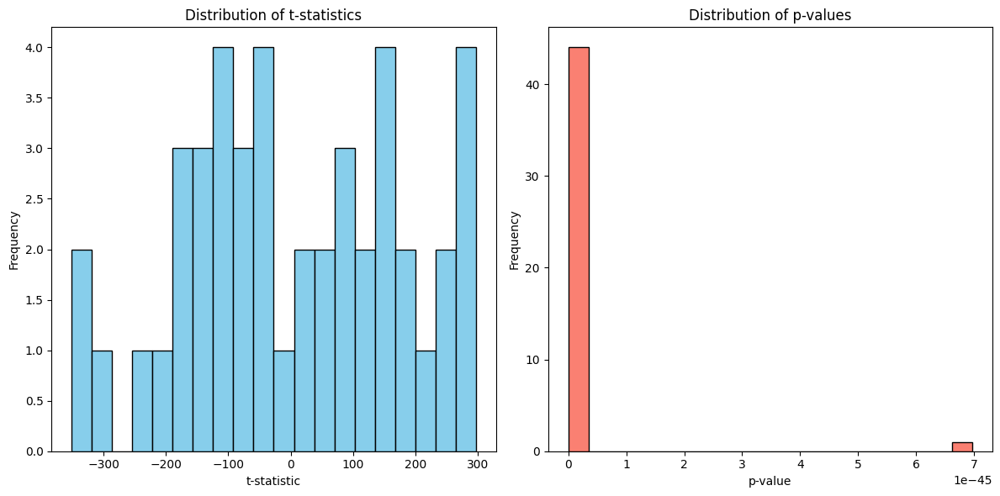

In [ ]:
from scipy.stats import ttest_ind
import os
import nibabel as nib
import matplotlib.pyplot as plt

# Directory containing functional connectivity maps (.nii format)
functional_connectivity_maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# List to store the paths of functional connectivity maps
map_paths = []

# Loop through each functional connectivity map in the folder
for filename in os.listdir(functional_connectivity_maps_folder):
    if filename.endswith('.nii'):
        map_paths.append(os.path.join(functional_connectivity_maps_folder, filename))

# Lists to store the t-statistics and p-values
t_statistics = []
p_values = []

# Perform t-tests on the functional connectivity maps pairwise
for i in range(len(map_paths)):
    for j in range(i + 1, len(map_paths)):
        map_path1 = map_paths[i]
        map_path2 = map_paths[j]

        # Load the functional connectivity maps
        map_data1 = nib.load(map_path1).get_fdata()
        map_data2 = nib.load(map_path2).get_fdata()

        # Flatten the maps for t-test
        map_data1_flat = map_data1.flatten()
        map_data2_flat = map_data2.flatten()

        # Perform t-test
        t_stat, p_val = ttest_ind(map_data1_flat, map_data2_flat)

        # Append t-statistic and p-value to lists
        t_statistics.append(t_stat)
        p_values.append(p_val)

# Plotting the t-statistics
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.hist(t_statistics, bins=20, color='skyblue', edgecolor='black')
plt.xlabel('t-statistic')
plt.ylabel('Frequency')
plt.title('Distribution of t-statistics')

# Plotting the p-values
plt.subplot(1, 2, 2)
plt.hist(p_values, bins=20, color='salmon', edgecolor='black')
plt.xlabel('p-value')
plt.ylabel('Frequency')
plt.title('Distribution of p-values')

plt.tight_layout()
plt.show()


In [ ]:
!pip install nilearn
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import os
import nibabel as nib
from nilearn import plotting

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-1'

# Loop through each functional connectivity map
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Flatten the connectivity map
        X = connectivity_map.reshape(-1, 1)

        # Find the optimal number of clusters using silhouette score
        best_score = -1
        best_n_clusters = 2
        for n_clusters in range(2, 4):  # Trying cluster numbers from 2 to 10
            kmeans = KMeans(n_clusters=n_clusters, random_state=42)
            labels = kmeans.fit_predict(X)
            score = silhouette_score(X, labels)
            if score > best_score:
                best_score = score
                best_n_clusters = n_clusters

        # Perform K-means clustering with the optimal number of clusters
        kmeans = KMeans(n_clusters=best_n_clusters, random_state=42)
        labels = kmeans.fit_predict(X)

        # Reshape the labels back to the original shape of the connectivity map
        clustered_map = labels.reshape(connectivity_map.shape)

        # Save the clustered map as a Nifti image
        clustered_map_img = nib.Nifti1Image(clustered_map, affine=nib.load(map_path).affine)
        output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
        nib.save(clustered_map_img, output_filename)

        # Optional: Plot the clustered map
        plotting.plot_roi(clustered_map_img, title=f"Clustered Map for {filename}", display_mode='ortho', cut_coords=None, colorbar=True)

print("Clustering analysis completed.")


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


just 3 clusters, not using the best fit

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Clustering analysis completed.


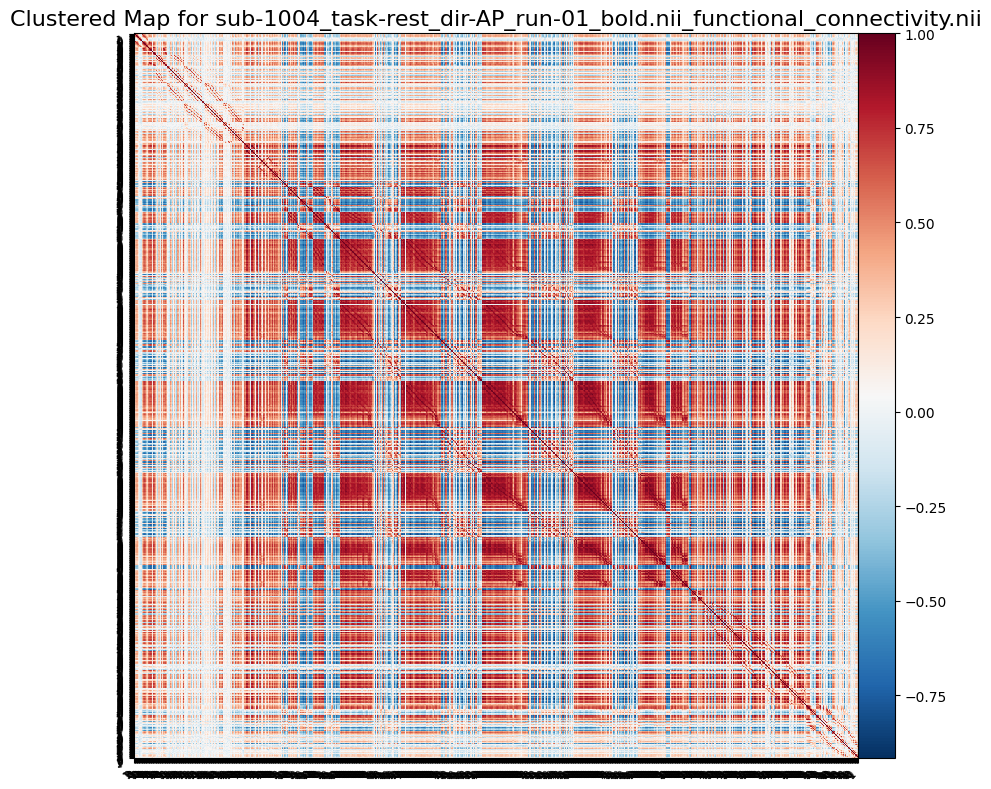

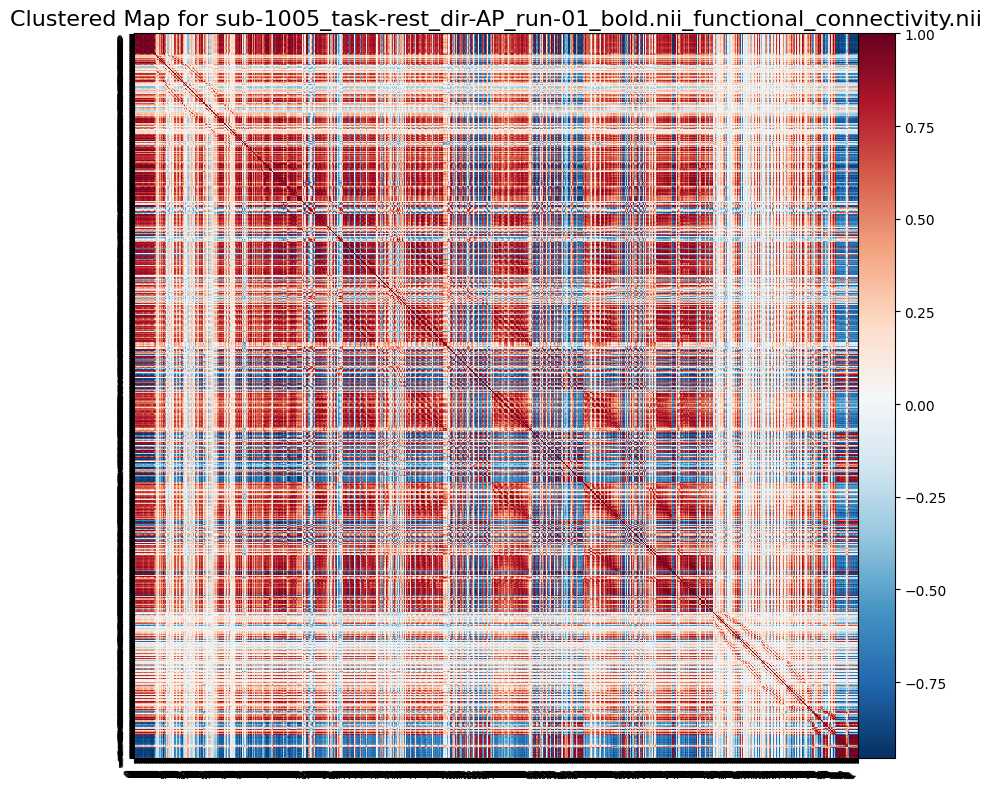

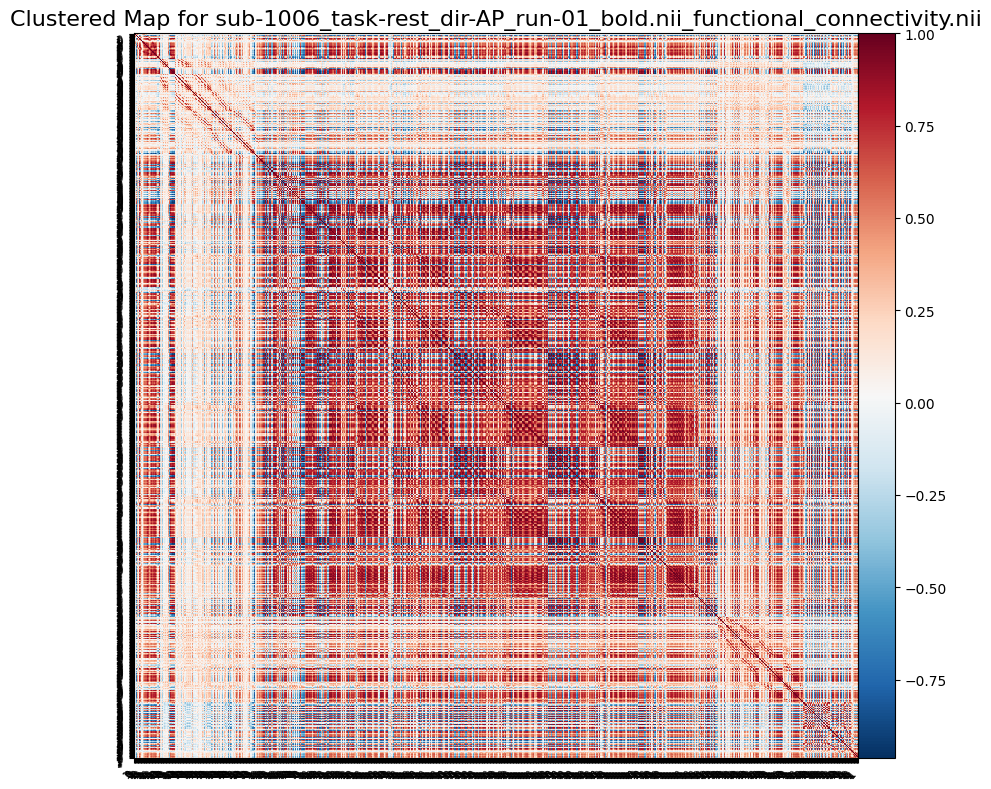

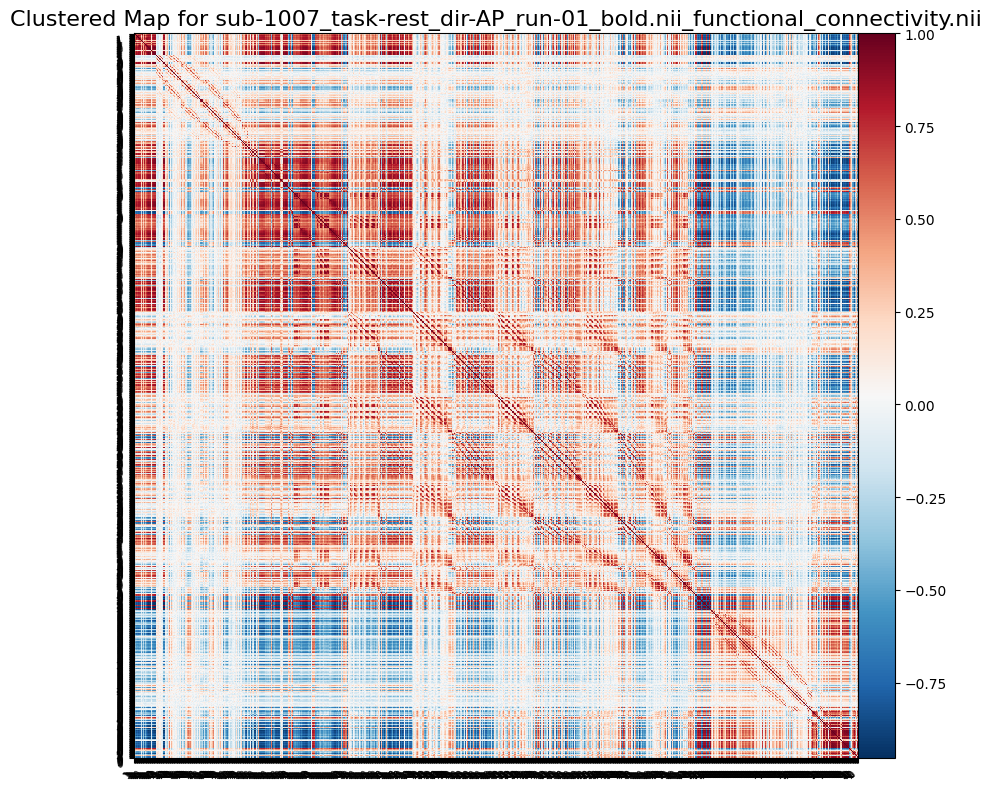

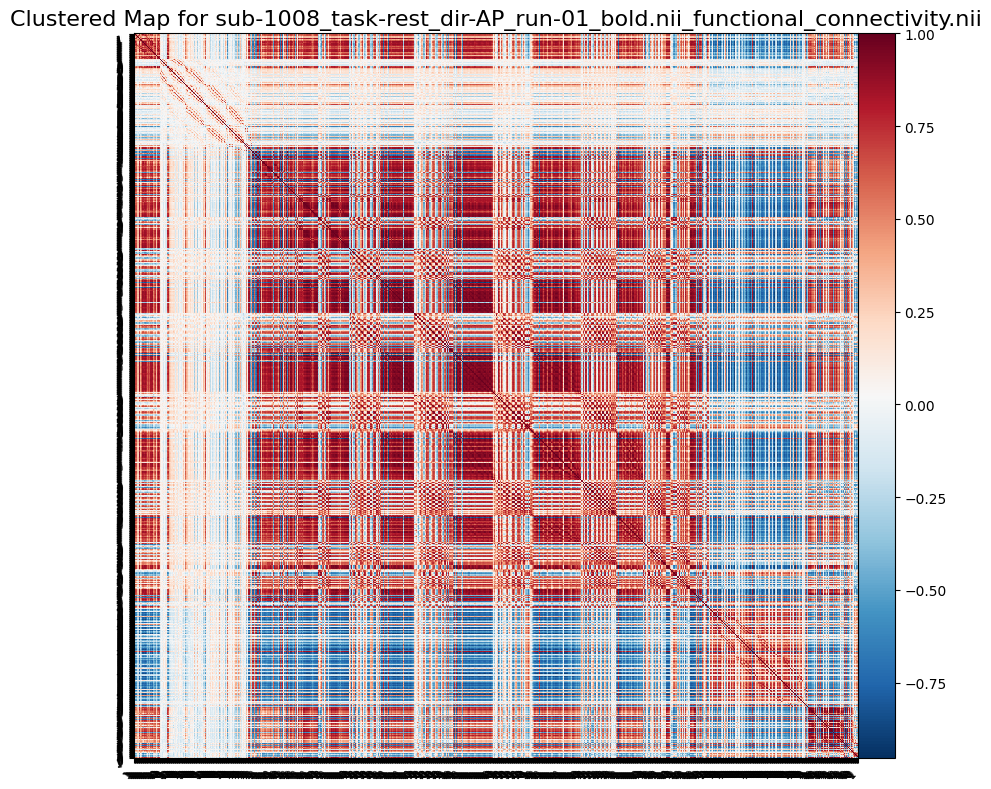

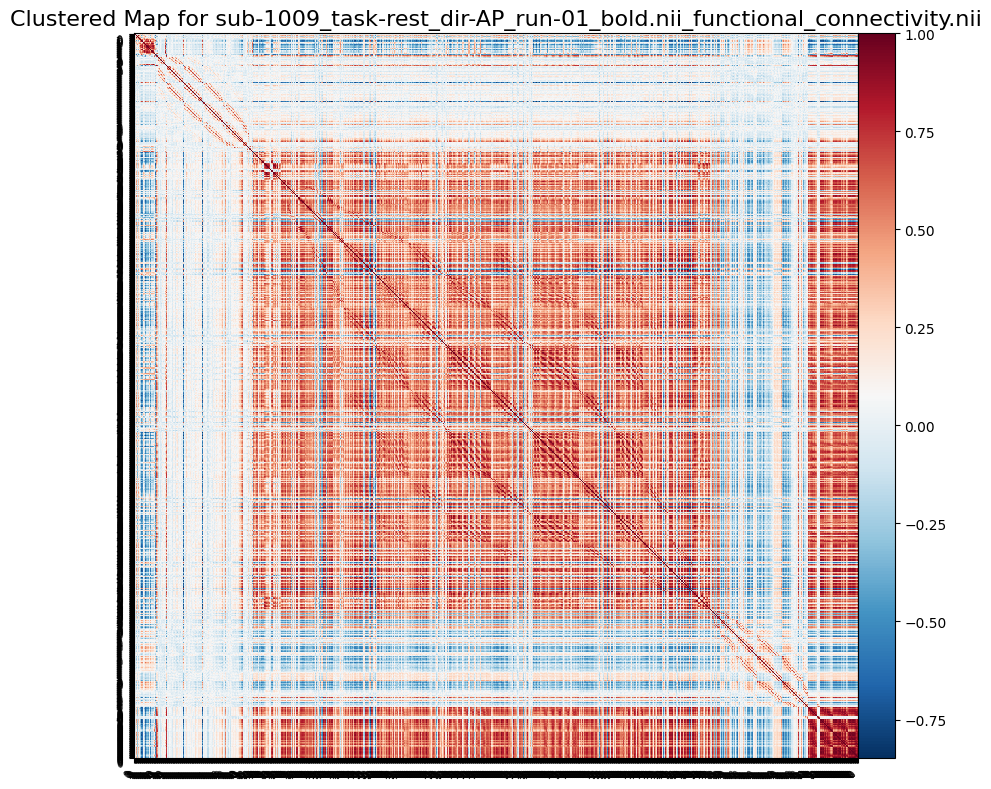

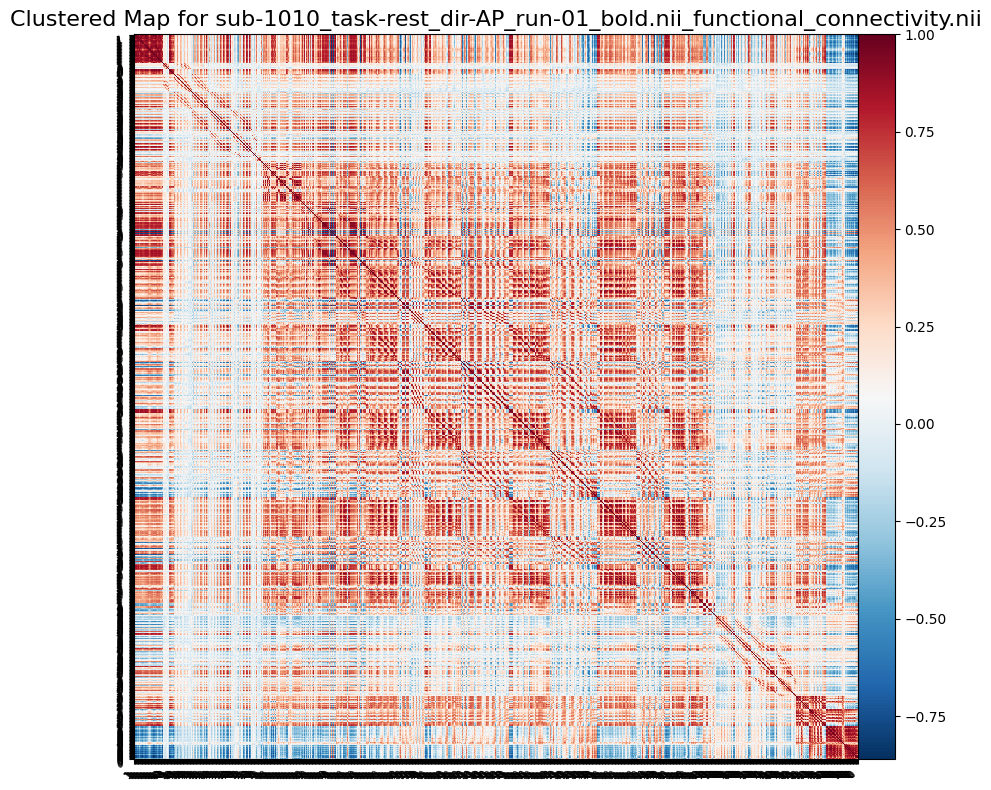

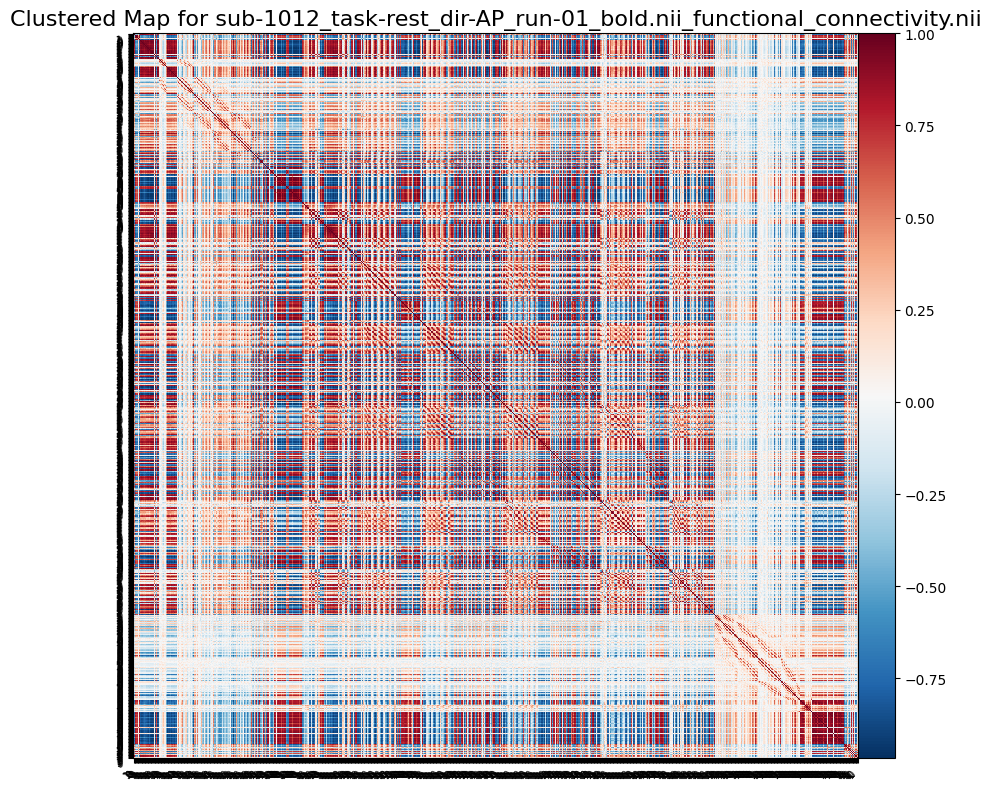

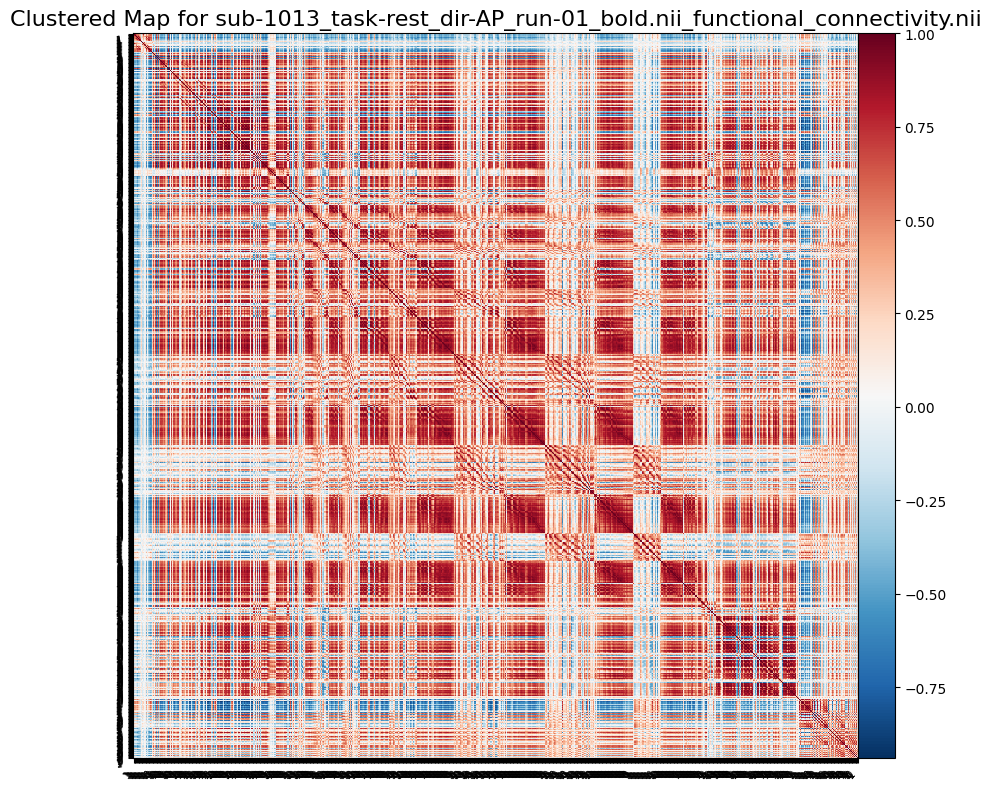

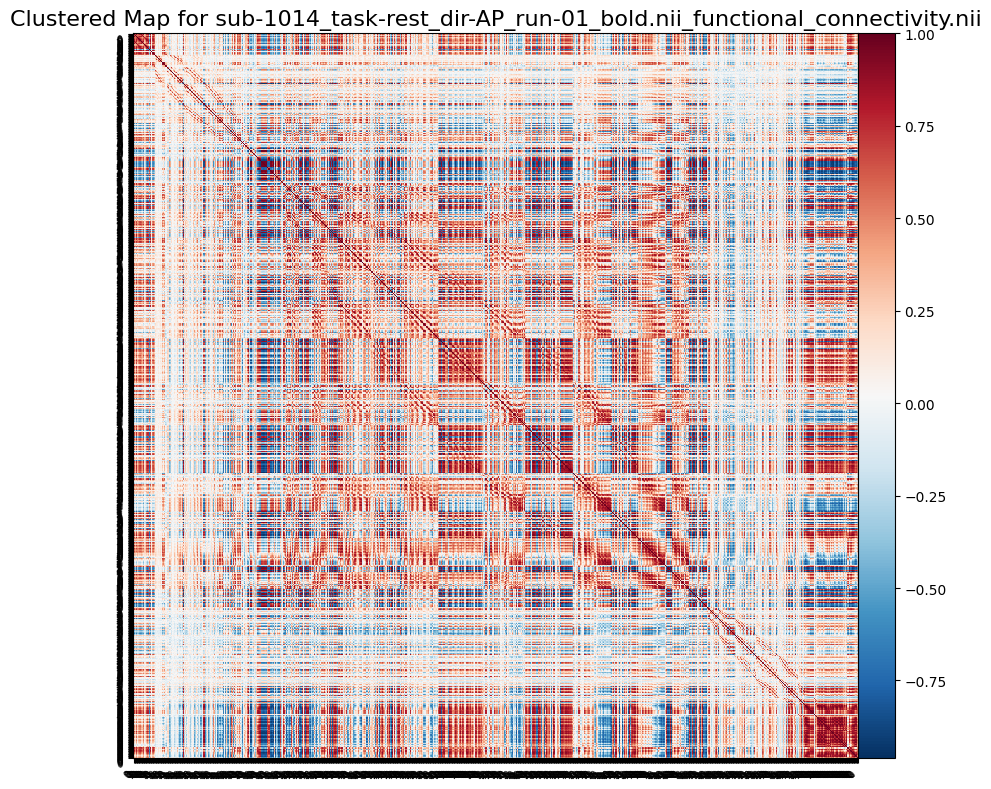

In [ ]:
!pip install nilearn
from sklearn.cluster import KMeans
import numpy as np
import os
import nibabel as nib
from nilearn import plotting

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-1'

# Loop through each functional connectivity map
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Perform K-means clustering with 3 clusters
        kmeans = KMeans(n_clusters=2, random_state=42)
        labels = kmeans.fit_predict(connectivity_map)

        # Plot the clustered map
        plotting.plot_matrix(connectivity_map, figure=(10, 8), labels=labels, title=f"Clustered Map for {filename}")

print("Clustering analysis completed.")


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Clustering analysis completed.


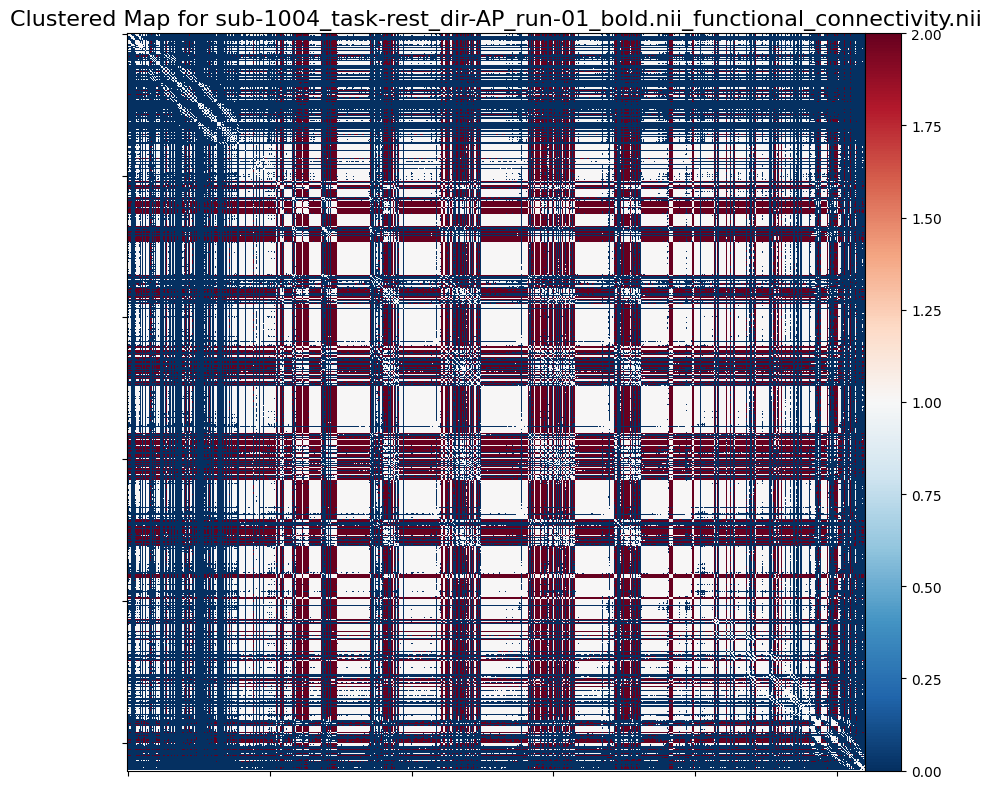

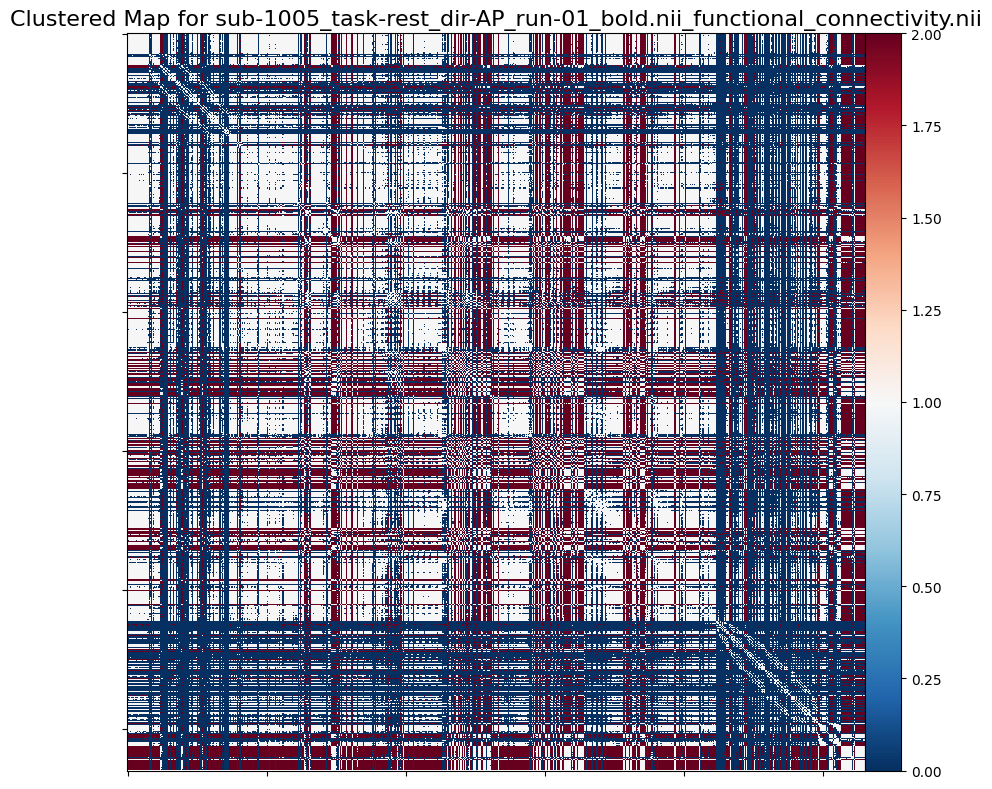

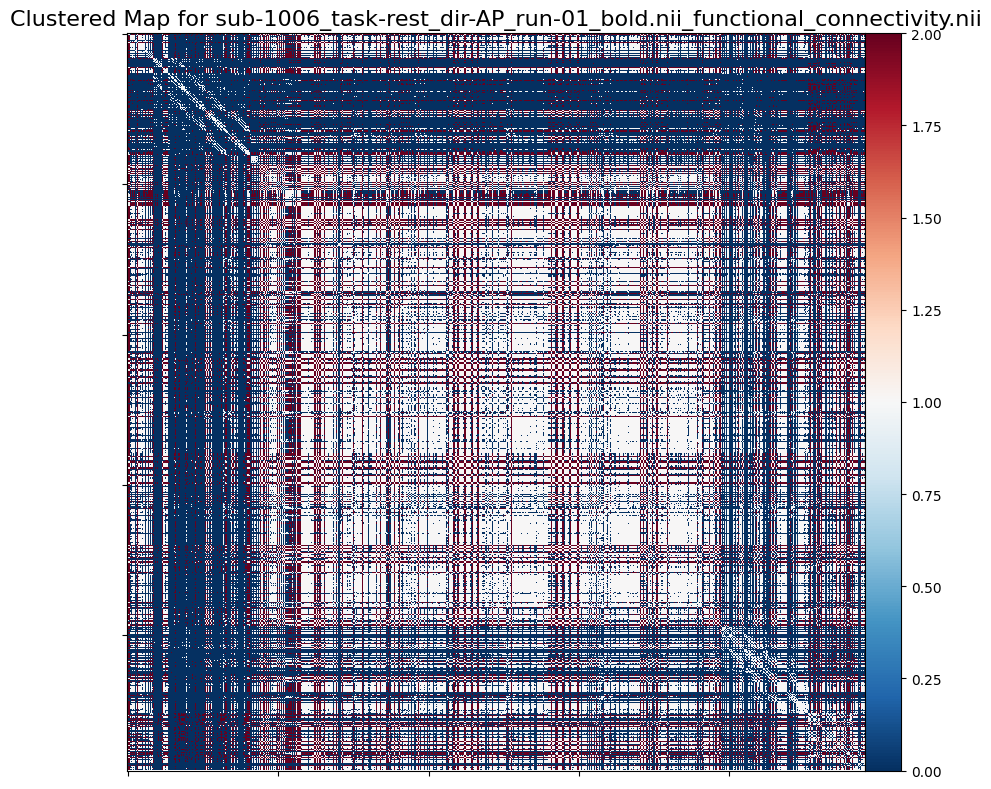

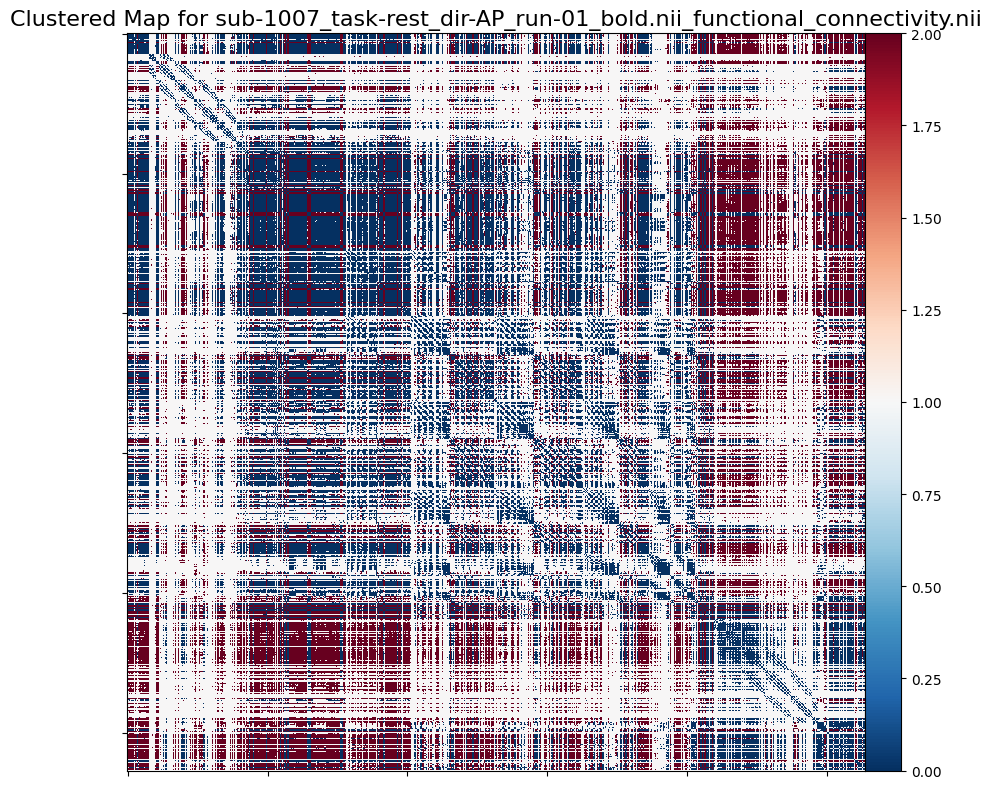

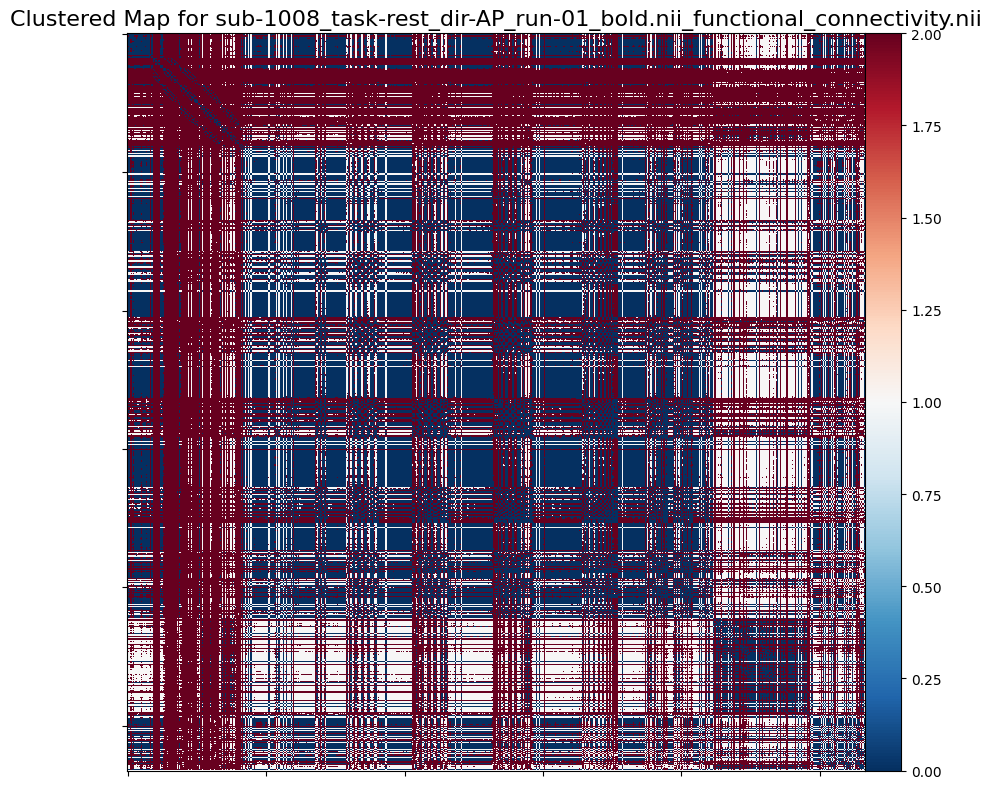

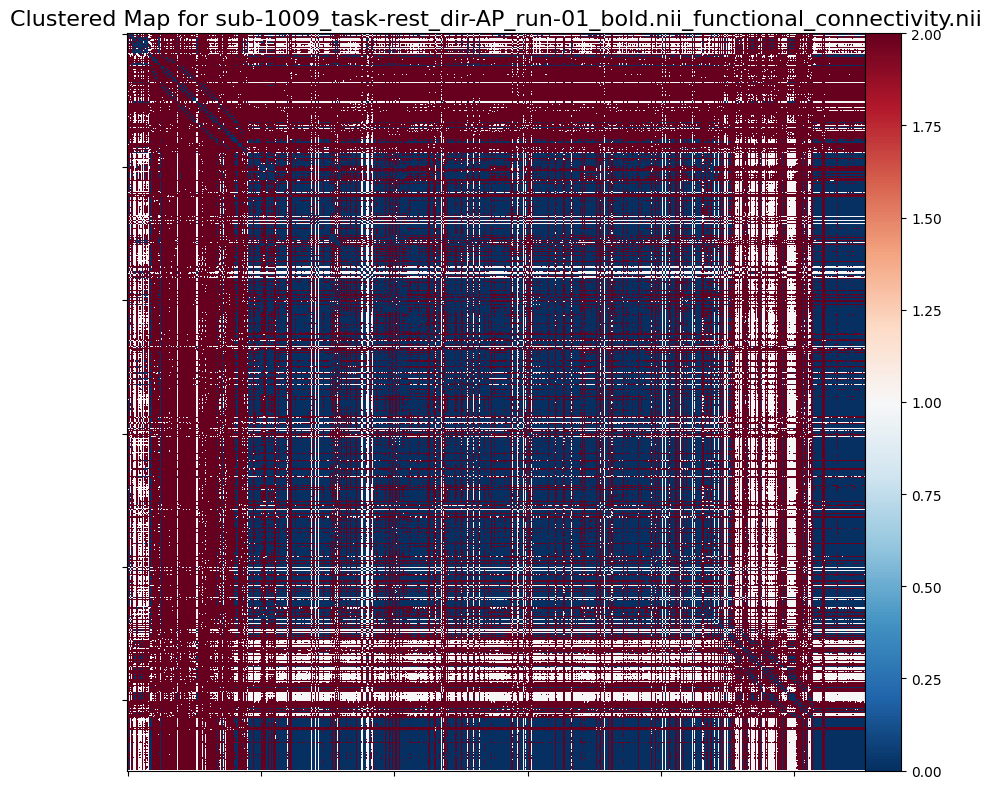

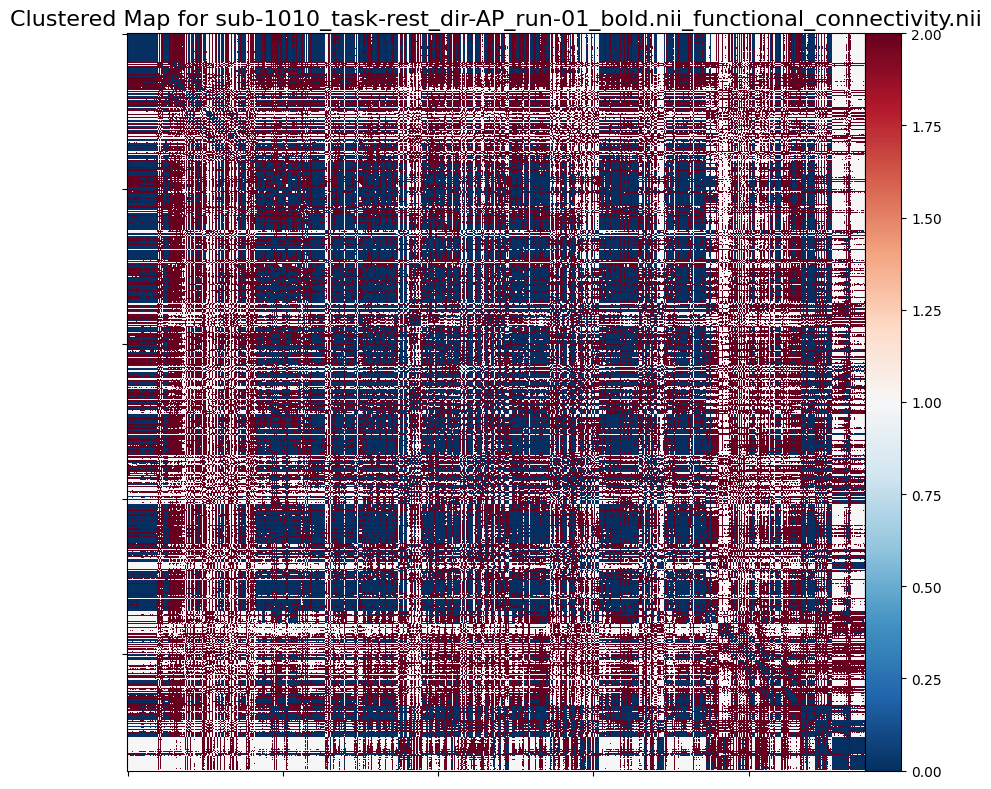

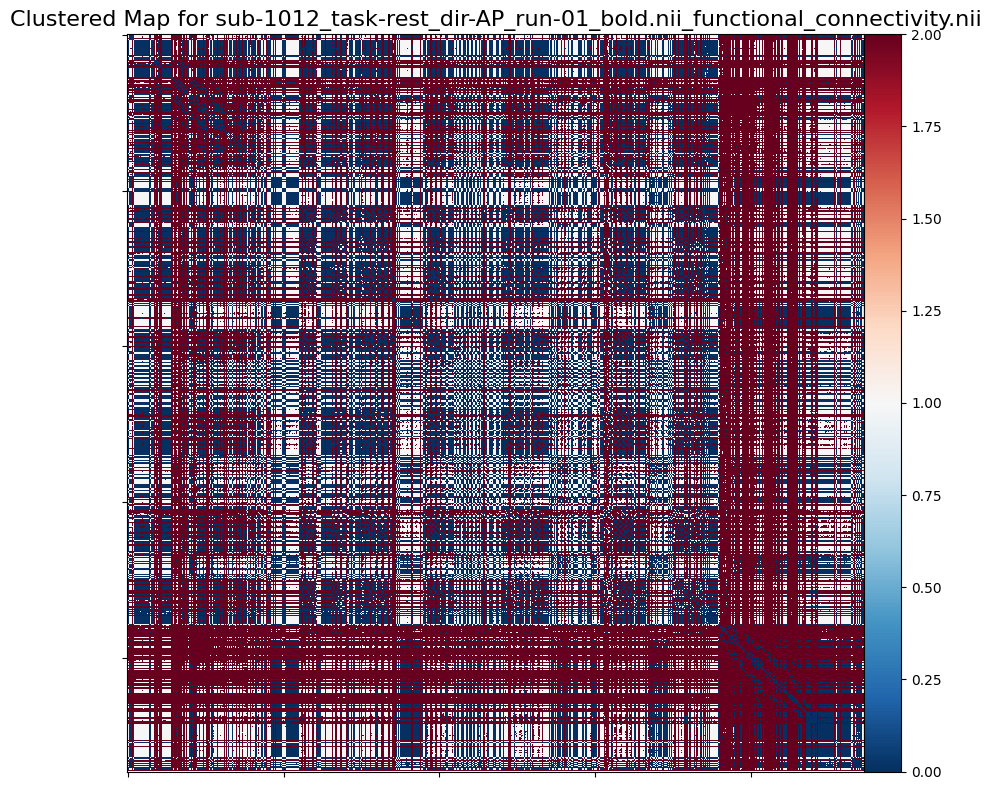

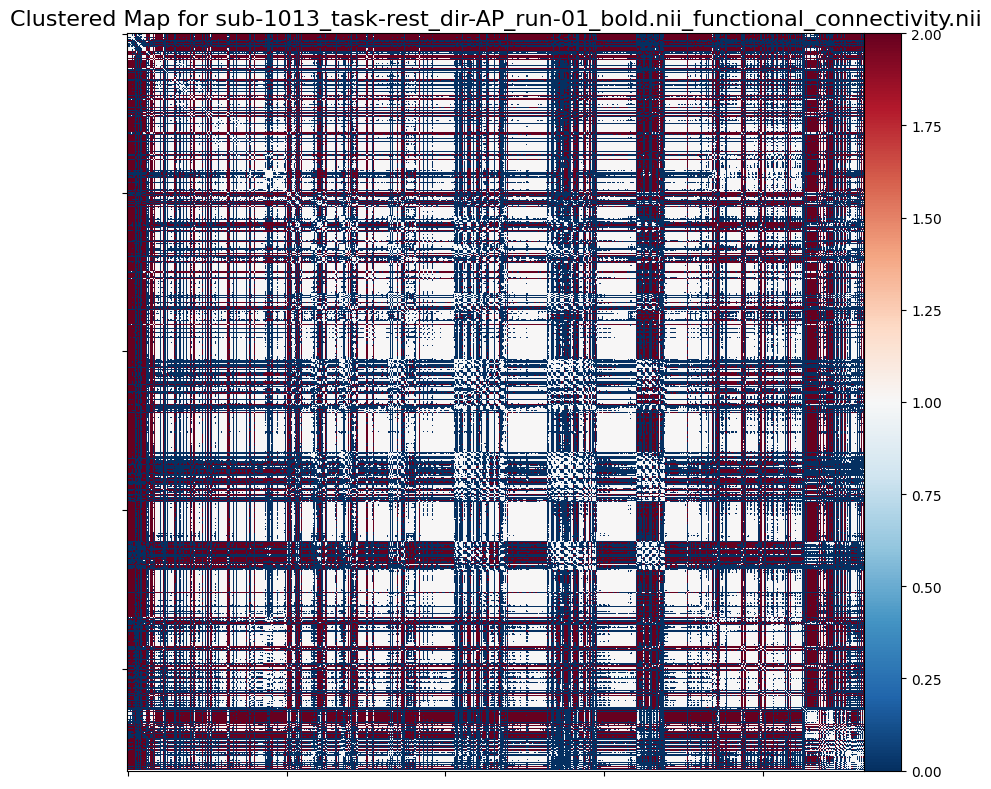

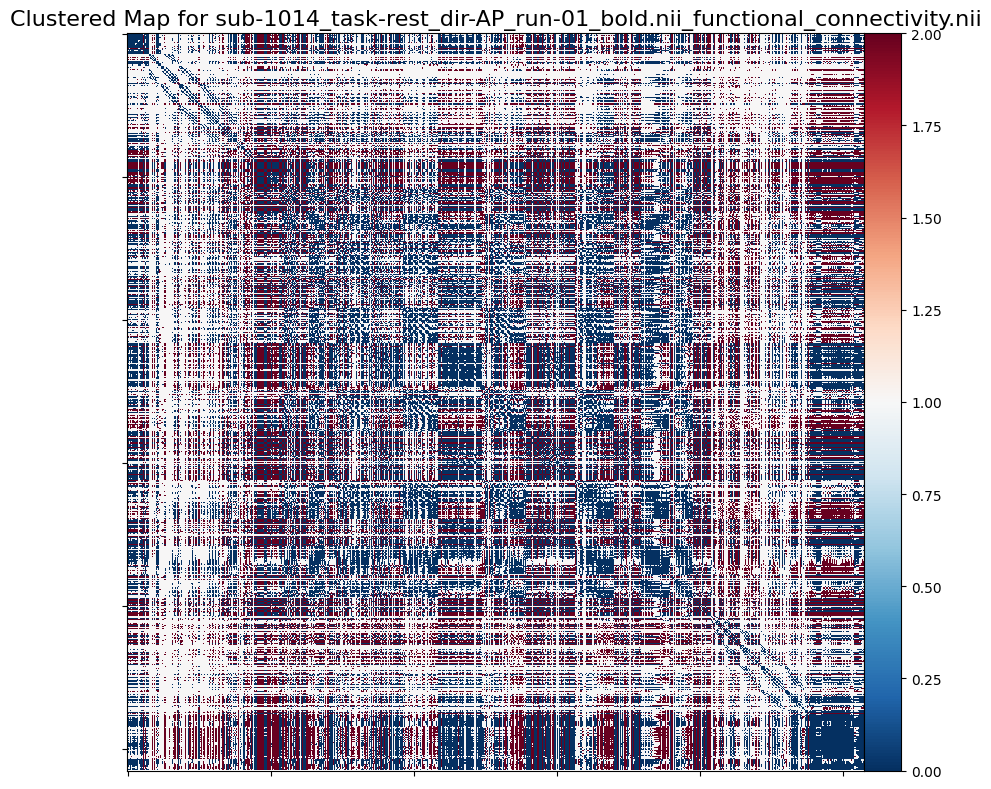

In [ ]:
from sklearn.cluster import KMeans
import numpy as np
import os
import nibabel as nib
from nilearn import plotting

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-1'

# Loop through each functional connectivity map
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Perform K-means clustering with 3 clusters
        kmeans = KMeans(n_clusters=3, random_state=42)
        labels = kmeans.fit_predict(connectivity_map.reshape(-1, 1))

        # Reshape the labels back to the original shape of the connectivity map
        clustered_map = labels.reshape(connectivity_map.shape)

        # Save the clustered map as a Nifti image
        clustered_map_img = nib.Nifti1Image(clustered_map, affine=nib.load(map_path).affine)
        output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
        nib.save(clustered_map_img, output_filename)

        # Optional: Plot the clustered map
        plotting.plot_matrix(clustered_map, figure=(10, 8), title=f"Clustered Map for {filename}", colorbar=True)

print("Clustering analysis completed.")


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Clustering analysis completed.
Cluster 0 vs. Cluster 1: t-statistic = 0.0, p-value = 1.0
Cluster 0 vs. Cluster 2: t-statistic = 0.0, p-value = 1.0
Cluster 1 vs. Cluster 2: t-statistic = 0.0, p-value = 1.0


NameError: name 'results' is not defined

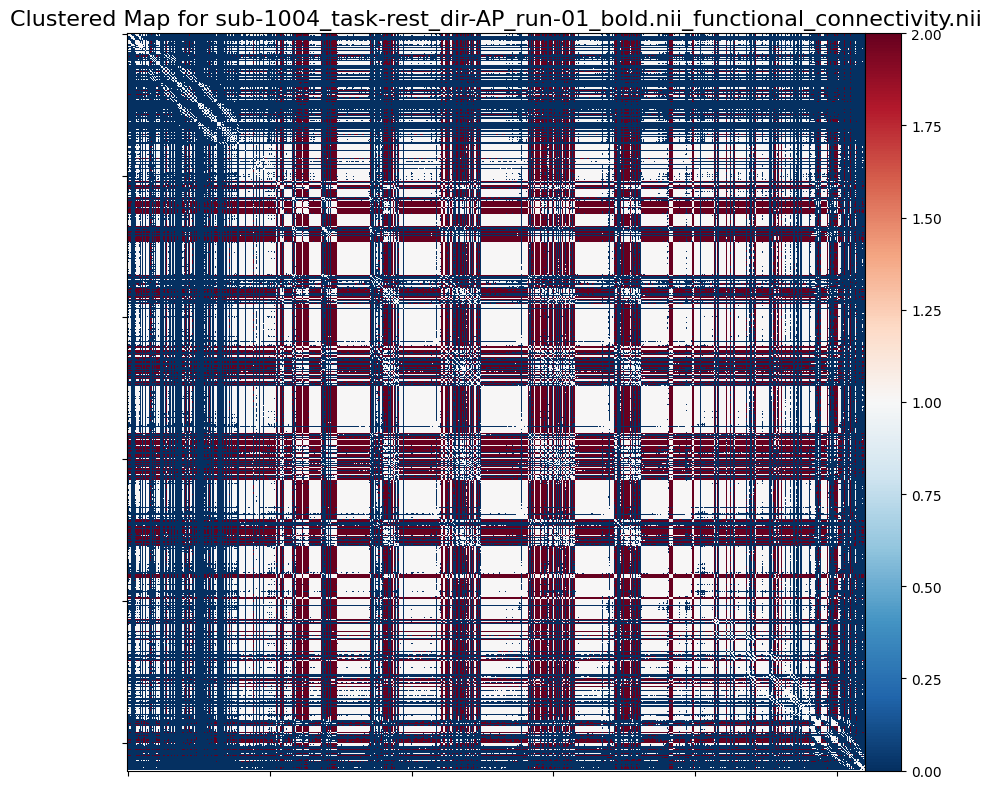

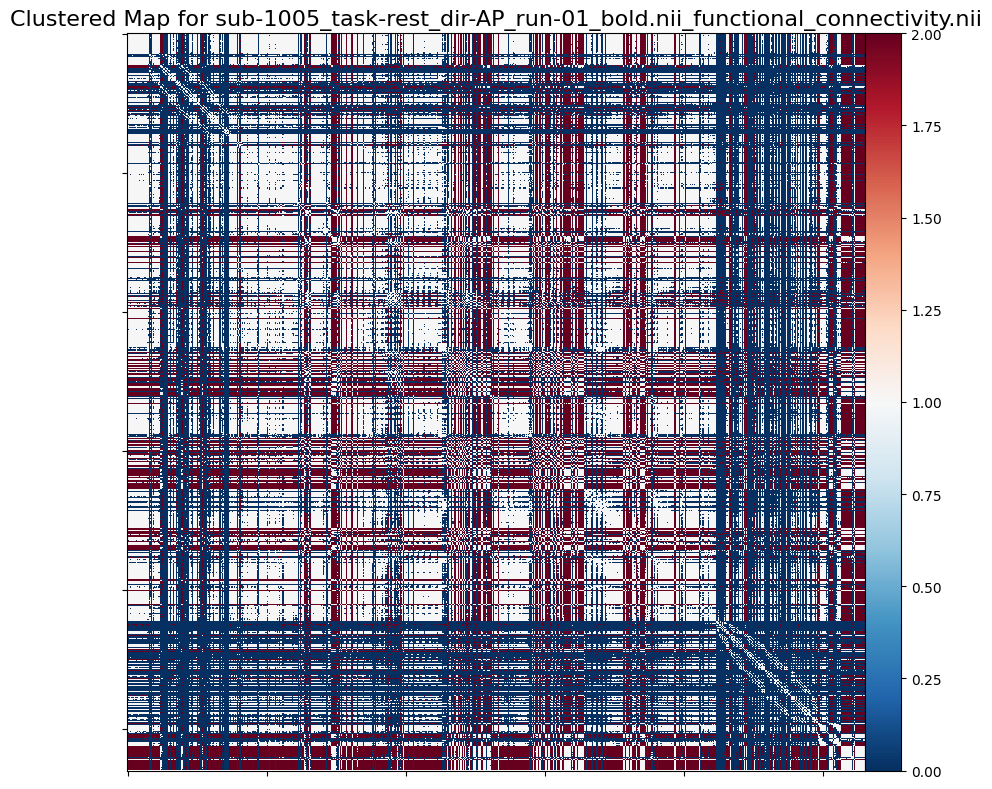

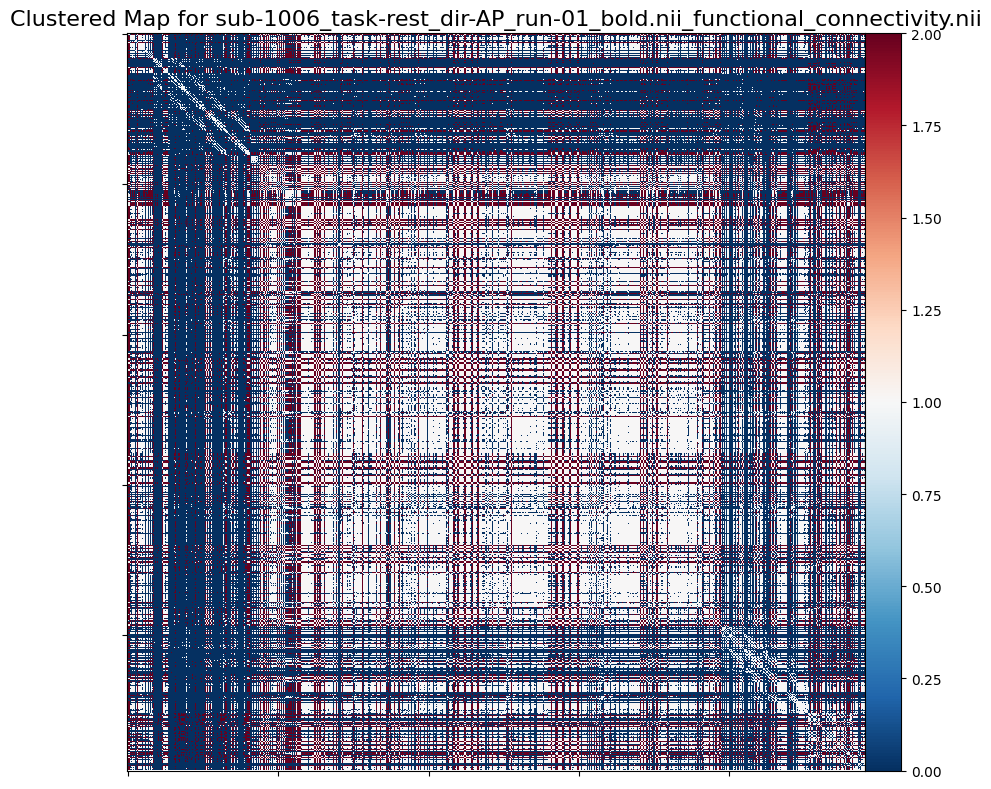

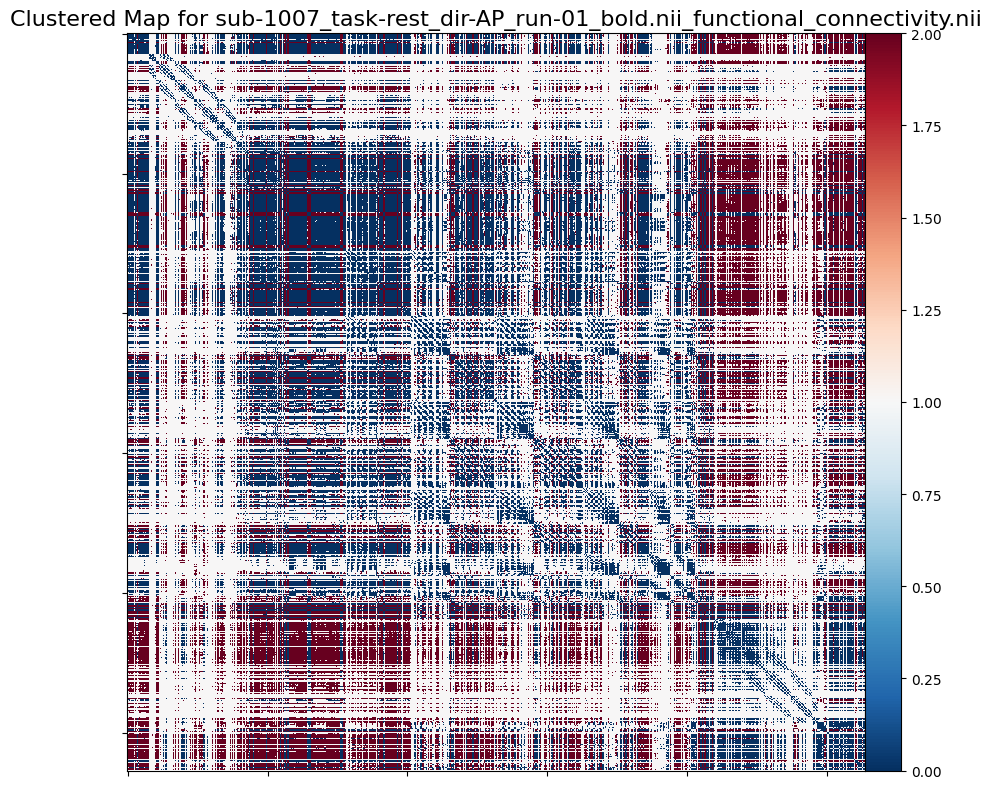

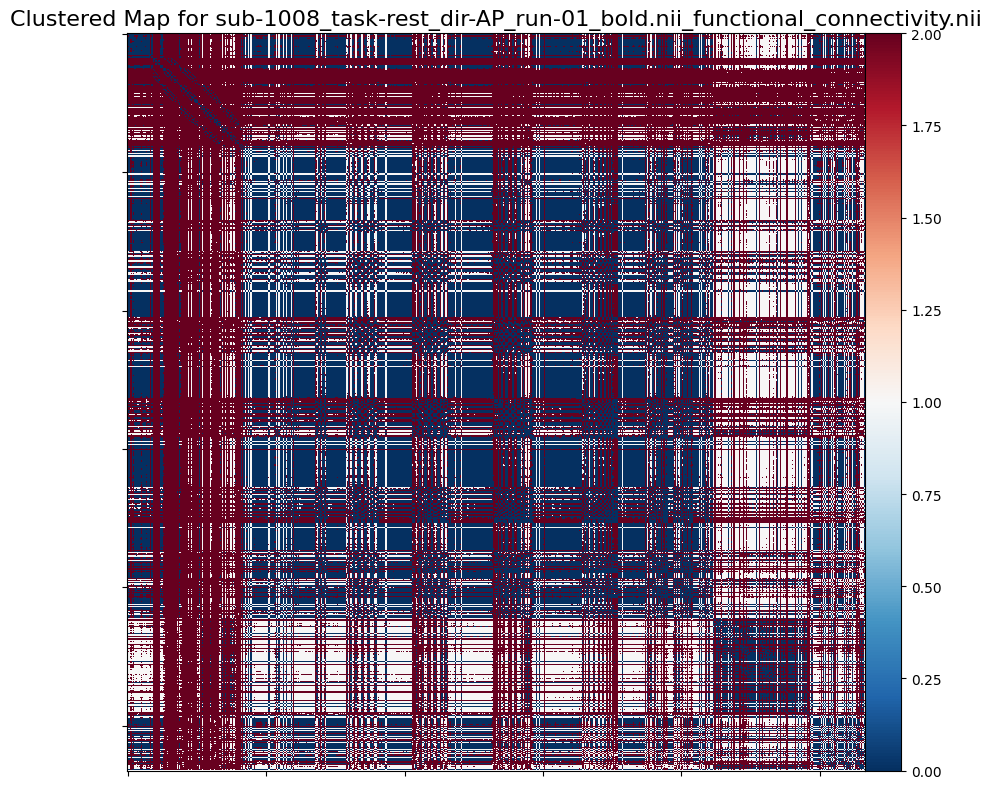

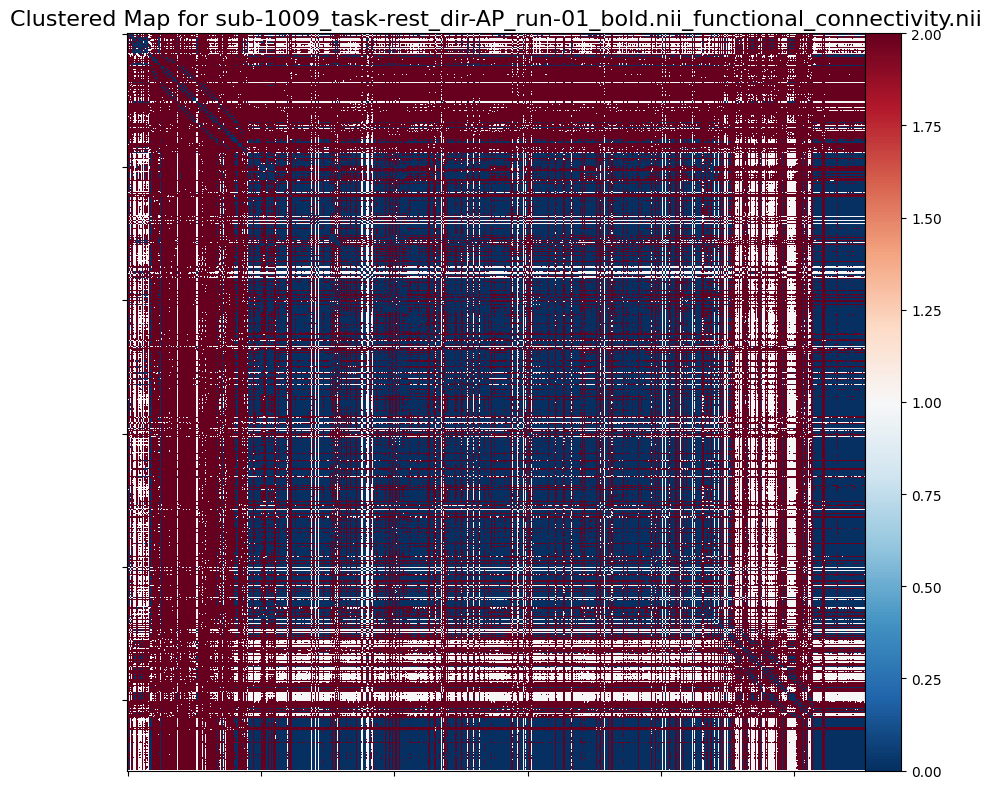

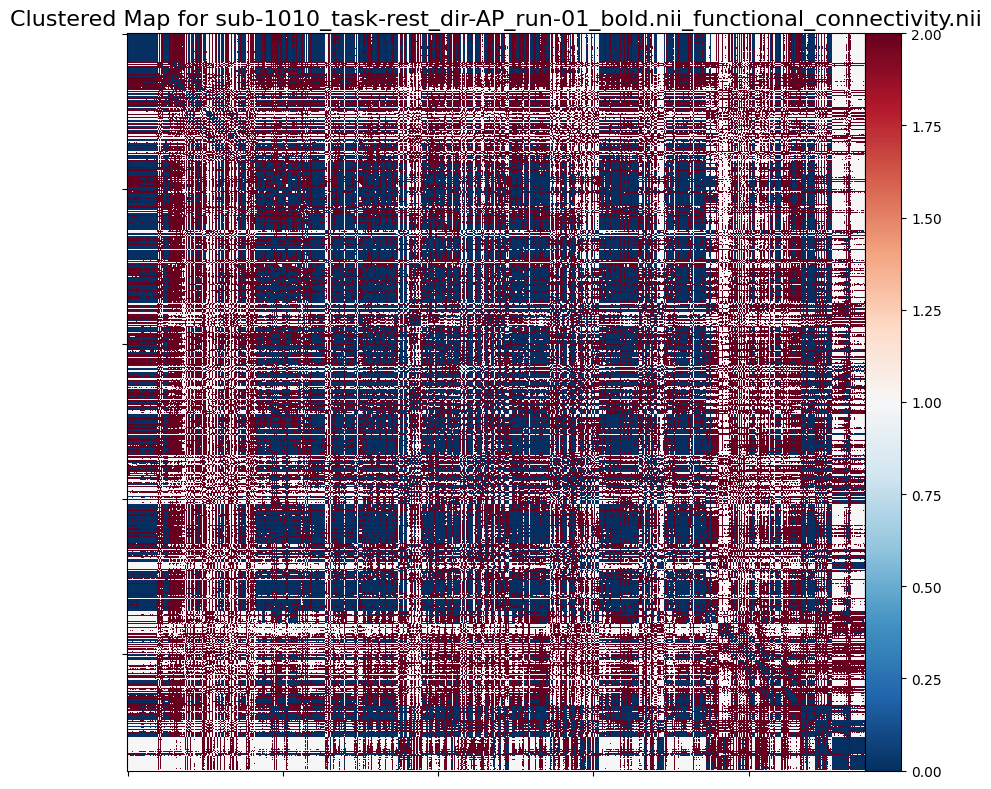

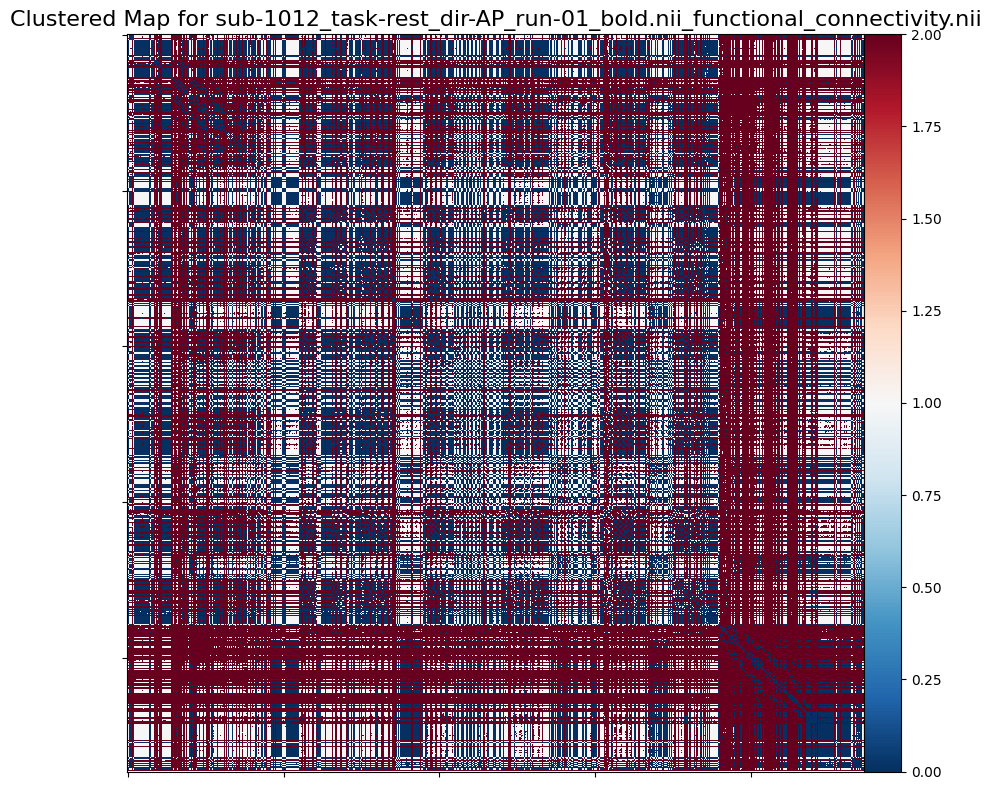

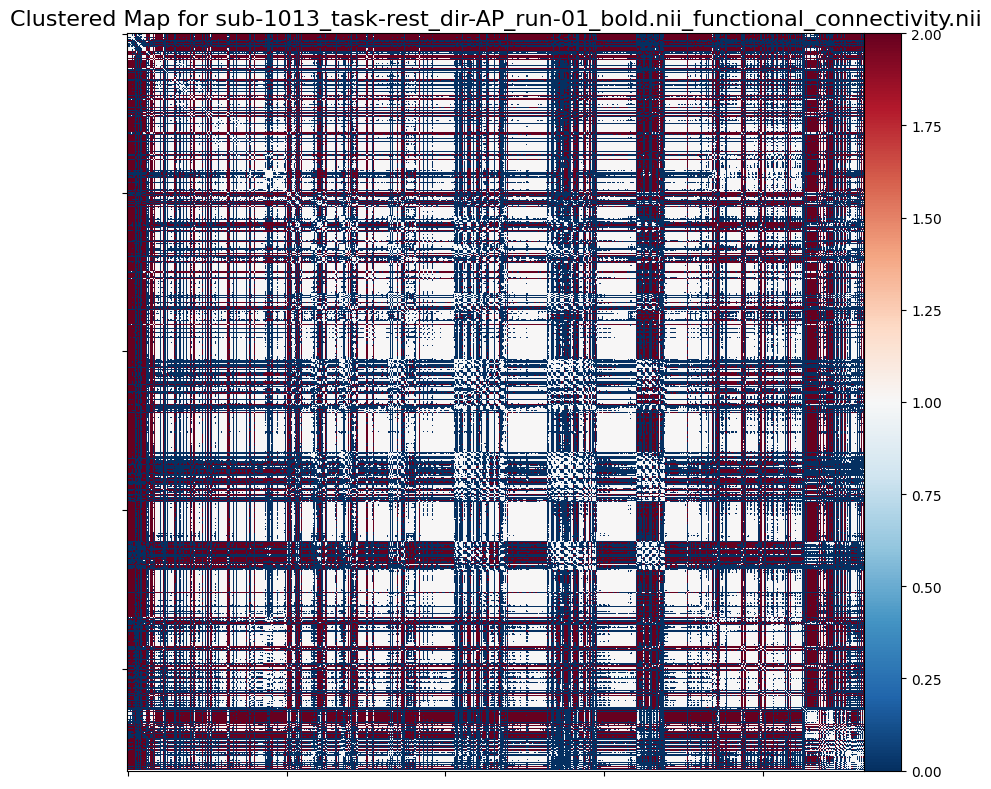

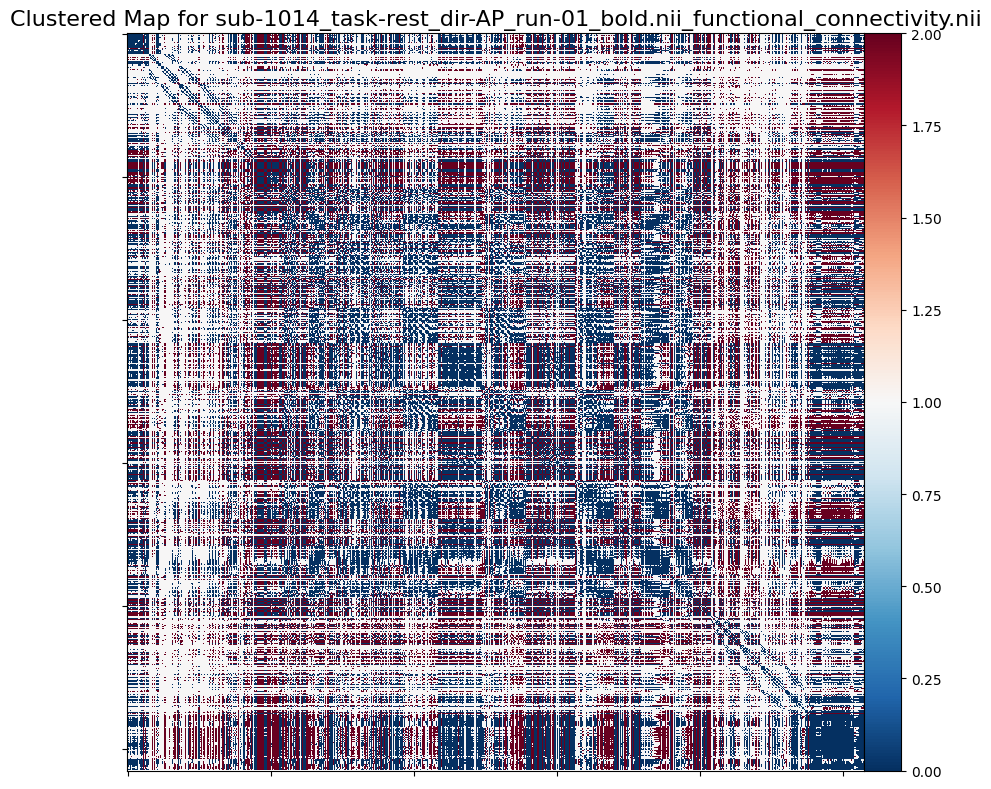

In [ ]:
from sklearn.cluster import KMeans
import numpy as np
import os
import nibabel as nib
from nilearn import plotting
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-1'

# Loop through each functional connectivity map
functional_connectivity_maps = []
cluster_labels = []
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Perform K-means clustering with 3 clusters
        kmeans = KMeans(n_clusters=3, random_state=42)
        labels = kmeans.fit_predict(connectivity_map.reshape(-1, 1))

        # Reshape the labels back to the original shape of the connectivity map
        clustered_map = labels.reshape(connectivity_map.shape)

        # Save the clustered map as a Nifti image
        clustered_map_img = nib.Nifti1Image(clustered_map, affine=nib.load(map_path).affine)
        output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
        nib.save(clustered_map_img, output_filename)
        plotting.plot_matrix(clustered_map, figure=(10, 8), title=f"Clustered Map for {filename}", colorbar=True)

        # Store the clustered map and labels for statistical testing
        functional_connectivity_maps.append(clustered_map)
        cluster_labels.append(labels)

print("Clustering analysis completed.")

# Resize the arrays in functional_connectivity_maps to a common shape
max_shape = np.max([arr.shape for arr in functional_connectivity_maps], axis=0)
resized_maps = []
for arr in functional_connectivity_maps:
    pad_width = [(0, max_shape[i] - arr.shape[i]) for i in range(len(arr.shape))]
    resized_arr = np.pad(arr, pad_width)
    resized_maps.append(resized_arr)

# Calculate the mean functional connectivity for each cluster
unique_clusters = np.unique(np.concatenate(cluster_labels))
cluster_means = []
for cluster in unique_clusters:
    cluster_indices = [i for i, label in enumerate(cluster_labels) if cluster in label]
    cluster_mean = np.mean([resized_maps[i] for i in cluster_indices], axis=0)
    cluster_means.append(cluster_mean)

# Perform statistical tests (e.g., t-tests) to compare clusters
t_stats = np.zeros((len(unique_clusters), len(unique_clusters)))
p_values = np.zeros((len(unique_clusters), len(unique_clusters)))
for i in range(len(unique_clusters)):
    for j in range(i + 1, len(unique_clusters)):
        cluster1 = cluster_means[i]
        cluster2 = cluster_means[j]
        t_stat, p_val = ttest_ind(cluster1.flatten(), cluster2.flatten())  # Flatten the arrays for t-test
        t_stats[i, j] = t_stat
        p_values[i, j] = p_val
        print(f"Cluster {i} vs. Cluster {j}: t-statistic = {t_stat}, p-value = {p_val}")



# Plotting the statistical results
plt.figure(figsize=(10, 8))
plt.imshow(p_values, cmap='coolwarm', interpolation='nearest')
plt.colorbar(label='p-value')
plt.title('Pairwise t-test p-values between clusters')
plt.xticks(np.arange(len(unique_clusters)), unique_clusters)
plt.yticks(np.arange(len(unique_clusters)), unique_clusters)
plt.xlabel('Cluster')
plt.ylabel('Cluster')
plt.show()



/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Clustering analysis completed.
Cluster 0 vs. Cluster 1: t-statistic = 0.0, p-value = 1.0


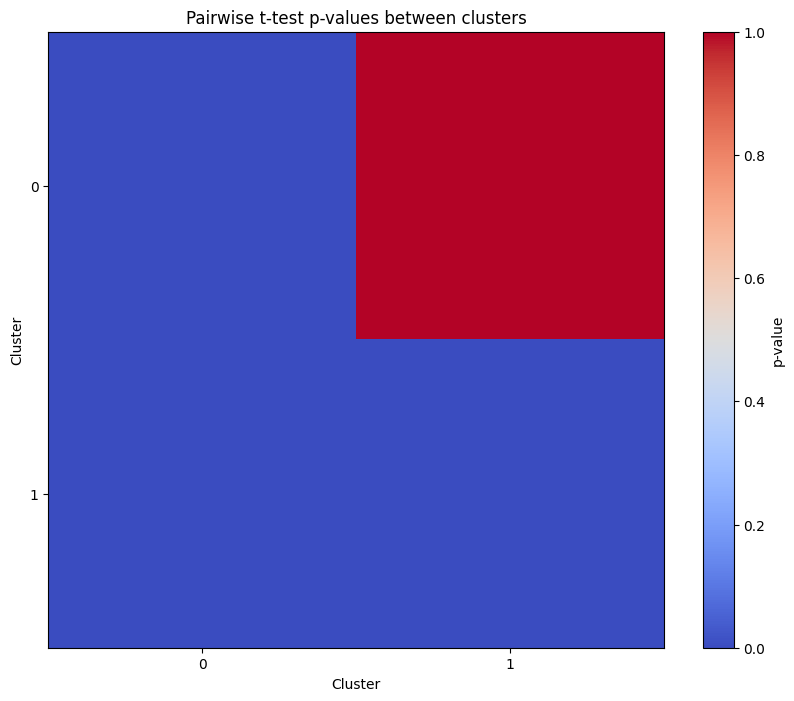

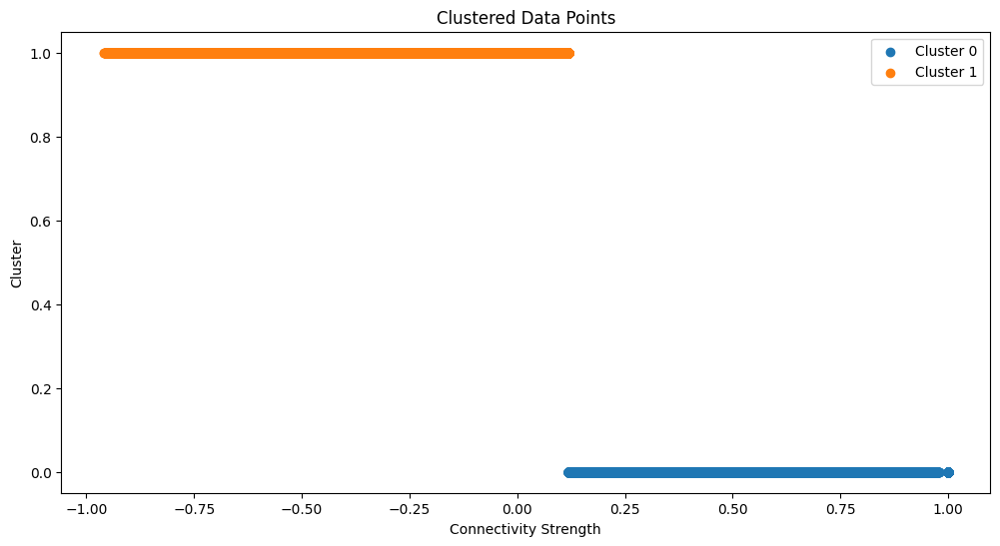

In [ ]:
!pip install nilearn
from sklearn.cluster import KMeans
import numpy as np
import os
import nibabel as nib
from nilearn import plotting
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-1'

# Initialize lists to store clustered maps and labels
functional_connectivity_maps = []
cluster_labels = []

# Loop through each functional connectivity map
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Perform K-means clustering with 3 clusters
        kmeans = KMeans(n_clusters=2, random_state=42)
        labels = kmeans.fit_predict(connectivity_map.reshape(-1, 1))

        # Reshape the labels back to the original shape of the connectivity map
        clustered_map = labels.reshape(connectivity_map.shape)

        # Save the clustered map as a Nifti image
        clustered_map_img = nib.Nifti1Image(clustered_map, affine=nib.load(map_path).affine)
        output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
        nib.save(clustered_map_img, output_filename)

        # Store the clustered map and labels for statistical testing
        functional_connectivity_maps.append(clustered_map)
        cluster_labels.append(labels)

print("Clustering analysis completed.")

# Resize the arrays in functional_connectivity_maps to a common shape
max_shape = np.max([arr.shape for arr in functional_connectivity_maps], axis=0)
resized_maps = []
for arr in functional_connectivity_maps:
    pad_width = [(0, max_shape[i] - arr.shape[i]) for i in range(len(arr.shape))]
    resized_arr = np.pad(arr, pad_width)
    resized_maps.append(resized_arr)

# Calculate the mean functional connectivity for each cluster
unique_clusters = np.unique(np.concatenate(cluster_labels))
cluster_means = []
for cluster in unique_clusters:
    cluster_indices = [i for i, label in enumerate(cluster_labels) if cluster in label]
    cluster_mean = np.mean([resized_maps[i] for i in cluster_indices], axis=0)
    cluster_means.append(cluster_mean)

# Perform statistical tests
t_stats = np.zeros((len(unique_clusters), len(unique_clusters)))
p_values = np.zeros((len(unique_clusters), len(unique_clusters)))
for i in range(len(unique_clusters)):
    for j in range(i + 1, len(unique_clusters)):
        cluster1 = cluster_means[i]
        cluster2 = cluster_means[j]
        t_stat, p_val = ttest_ind(cluster1.flatten(), cluster2.flatten())  # Flatten the arrays for t-test
        t_stats[i, j] = t_stat
        p_values[i, j] = p_val
        print(f"Cluster {i} vs. Cluster {j}: t-statistic = {t_stat}, p-value = {p_val}")

# Plotting the statistical results
plt.figure(figsize=(10, 8))
plt.imshow(p_values, cmap='coolwarm', interpolation='nearest')
plt.colorbar(label='p-value')
plt.title('Pairwise t-test p-values between clusters')
plt.xticks(np.arange(len(unique_clusters)), unique_clusters)
plt.yticks(np.arange(len(unique_clusters)), unique_clusters)
plt.xlabel('Cluster')
plt.ylabel('Cluster')
plt.show()

# Scatter plot of the clustered data points
plt.figure(figsize=(12, 6))
for i in range(2):  # Assuming 2 clusters
    cluster_data = connectivity_map[..., labels.reshape(connectivity_map.shape) == i].reshape(-1)
    plt.scatter(cluster_data, np.ones_like(cluster_data) * i, label=f'Cluster {i}')
plt.xlabel('Connectivity Strength')
plt.ylabel('Cluster')
plt.title('Clustered Data Points')
plt.legend()
plt.show()


silhoutte score

In [ ]:
from sklearn.cluster import KMeans
import numpy as np
import os
import nibabel as nib
from nilearn import plotting
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-1'

# Loop through each functional connectivity map
functional_connectivity_maps = []
cluster_labels = []
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Find the optimal number of clusters using silhouette score
        best_score = -1
        best_n_clusters = 2
        for n_clusters in range(2, 11):  # Trying cluster numbers from 2 to 10
            kmeans = KMeans(n_clusters=n_clusters, random_state=42)
            labels = kmeans.fit_predict(connectivity_map.reshape(-1, 1))
            score = silhouette_score(connectivity_map.reshape(-1, 1), labels)
            if score > best_score:
                best_score = score
                best_n_clusters = n_clusters

        # Perform K-means clustering with the optimal number of clusters
        kmeans = KMeans(n_clusters=best_n_clusters, random_state=42)
        labels = kmeans.fit_predict(connectivity_map.reshape(-1, 1))

        # Reshape the labels back to the original shape of the connectivity map
        clustered_map = labels.reshape(connectivity_map.shape)

        # Save the clustered map as a Nifti image
        clustered_map_img = nib.Nifti1Image(clustered_map, affine=nib.load(map_path).affine)
        output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
        nib.save(clustered_map_img, output_filename)
        plotting.plot_matrix(clustered_map, figure=(10, 8), title=f"Clustered Map for {filename}", colorbar=True)

        # Store the clustered map and labels for statistical testing
        functional_connectivity_maps.append(clustered_map)
        cluster_labels.append(labels)

print("Clustering analysis completed.")

# Resize the arrays in functional_connectivity_maps to a common shape
max_shape = np.max([arr.shape for arr in functional_connectivity_maps], axis=0)
resized_maps = []
for arr in functional_connectivity_maps:
    pad_width = [(0, max_shape[i] - arr.shape[i]) for i in range(len(arr.shape))]
    resized_arr = np.pad(arr, pad_width)
    resized_maps.append(resized_arr)

# Calculate the mean functional connectivity for each cluster
unique_clusters = np.unique(np.concatenate(cluster_labels))
cluster_means = []
for cluster in unique_clusters:
    cluster_indices = [i for i, label in enumerate(cluster_labels) if cluster in label]
    cluster_mean = np.mean([resized_maps[i] for i in cluster_indices], axis=0)
    cluster_means.append(cluster_mean)

# Perform statistical tests
t_stats = np.zeros((len(unique_clusters), len(unique_clusters)))
p_values = np.zeros((len(unique_clusters), len(unique_clusters)))
for i in range(len(unique_clusters)):
    for j in range(i + 1, len(unique_clusters)):
        cluster1 = cluster_means[i]
        cluster2 = cluster_means[j]
        t_stat, p_val = ttest_ind(cluster1.flatten(), cluster2.flatten())
        t_stats[i, j] = t_stat
        p_values[i, j] = p_val
        print(f"Cluster {i} vs. Cluster {j}: t-statistic = {t_stat}, p-value = {p_val}")


# Plotting the statistical results
plt.figure(figsize=(10, 8))
plt.imshow(p_values, cmap='coolwarm', interpolation='nearest')
plt.colorbar(label='p-value')
plt.title('Pairwise t-test p-values between clusters')
plt.xticks(np.arange(len(unique_clusters)), unique_clusters)
plt.yticks(np.arange(len(unique_clusters)), unique_clusters)
plt.xlabel('Cluster')
plt.ylabel('Cluster')
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


K cluster and stat mapping:

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', 424.43954691750855, 0.0)


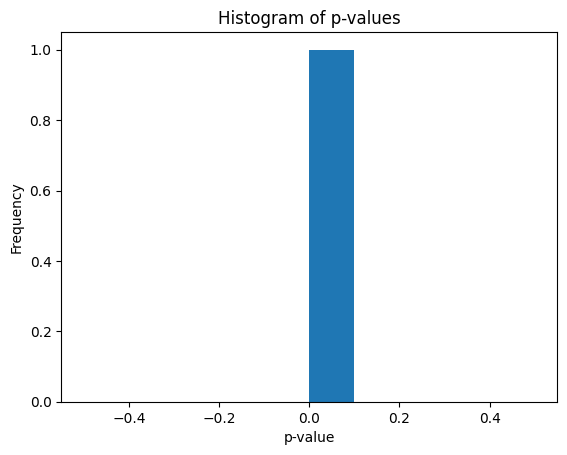

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', 442.3586483074931, 0.0)


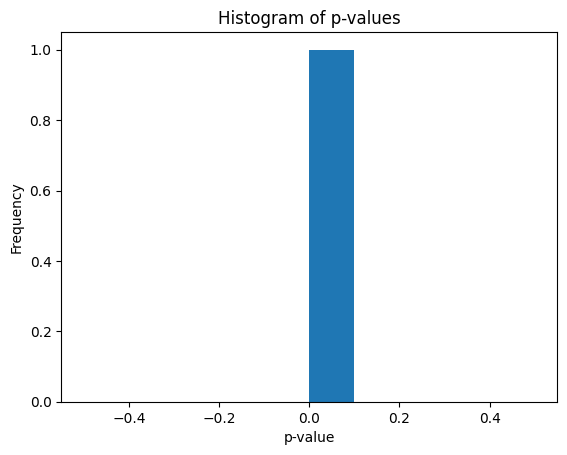

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', -415.39952288019384, 0.0)


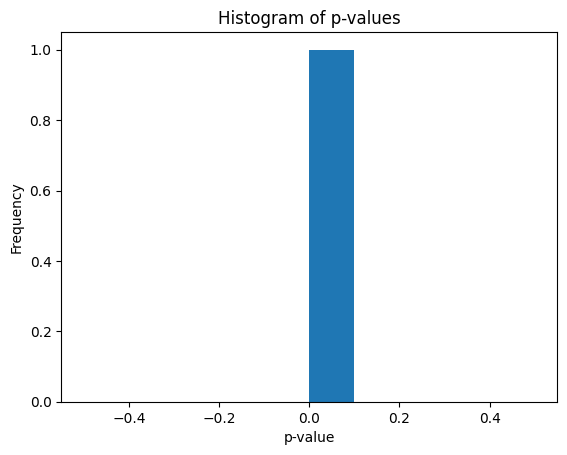

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', -218.29148380409646, 0.0)


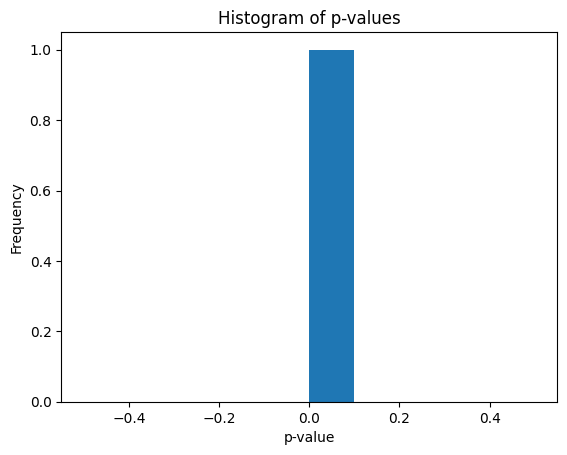

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', -335.21079442804285, 0.0)


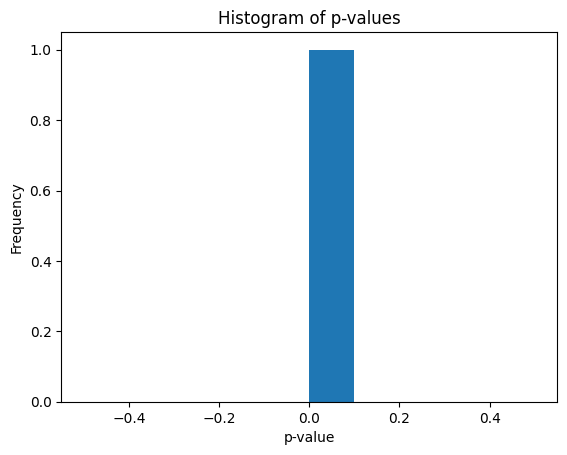

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', 584.2102422123234, 0.0)


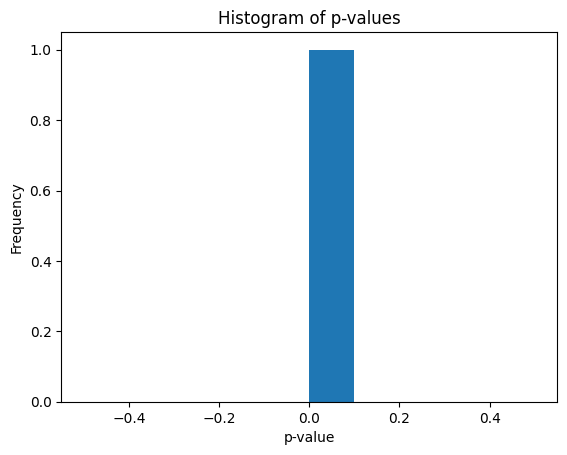

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', -391.24772842311785, 0.0)


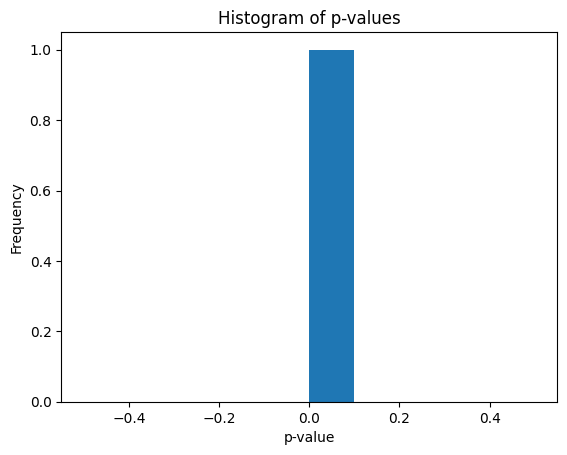

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', -122.60411984226099, 0.0)


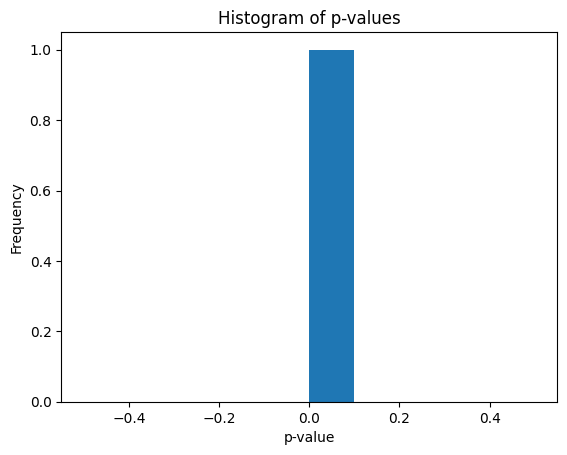

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', 440.1755991340988, 0.0)


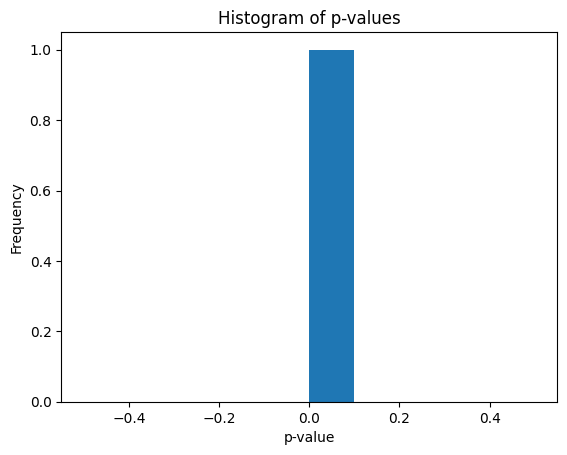

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

('Cluster 0 vs. Cluster 1', 196.33708233878684, 0.0)


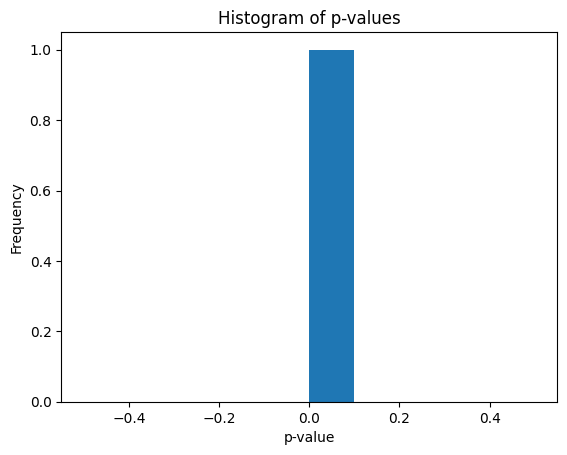

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import ttest_ind
import numpy as np
import os
import nibabel as nib
from nilearn import plotting

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-2'

# Define a function to perform clustering and statistical testing
def cluster_and_test(maps_folder, output_dir):
    # Loop through each functional connectivity map
    for filename in os.listdir(maps_folder):
        if filename.endswith('.nii'):
            map_path = os.path.join(maps_folder, filename)

            # Load the functional connectivity map
            connectivity_map = nib.load(map_path).get_fdata()

            # Reshape the connectivity map to 2D
            X = connectivity_map.reshape(-1, connectivity_map.shape[-1])

            # Find the optimal number of clusters using silhouette score
            best_score = -1
            best_n_clusters = 2
            for n_clusters in range(2, 11):  # Trying cluster numbers from 2 to 10
                kmeans = KMeans(n_clusters=n_clusters, random_state=42)
                labels = kmeans.fit_predict(X)
                score = silhouette_score(X, labels)
                if score > best_score:
                    best_score = score
                    best_n_clusters = n_clusters

            # Perform K-means clustering with the optimal number of clusters
            kmeans = KMeans(n_clusters=best_n_clusters, random_state=42)
            labels = kmeans.fit_predict(X)

            # Reshape the labels back to the original shape of the connectivity map
            clustered_map = labels.reshape(connectivity_map.shape[:-1])

            # Save the clustered map as a Nifti image
            clustered_map_img = nib.Nifti1Image(clustered_map, affine=nib.load(map_path).affine)
            output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
            nib.save(clustered_map_img, output_filename)

            # Perform statistical tests (e.g., t-tests) to compare clusters
            results = []
            for i in range(best_n_clusters):
                for j in range(i + 1, best_n_clusters):
                    cluster1 = connectivity_map[..., labels == i]
                    cluster2 = connectivity_map[..., labels == j]
                    t_stat, p_val = ttest_ind(cluster1.flatten(), cluster2.flatten())
                    results.append((f"Cluster {i} vs. Cluster {j}", t_stat, p_val))

            # Print or store the results for further analysis
            for result in results:
                print(result)

            #Plotting the results
            p_values = [result[2] for result in results]
            plt.hist(p_values, bins=10)
            plt.xlabel('p-value')
            plt.ylabel('Frequency')
            plt.title('Histogram of p-values')
            plt.show()

# Call the function to perform clustering and statistical testing
cluster_and_test(maps_folder, output_dir)


In [ ]:
!pip install nilearn
!pip install nibabel
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import ttest_ind
import numpy as np
import os
import nibabel as nib
from nilearn import plotting
import matplotlib.pyplot as plt

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-2'

# Define a function to perform clustering and statistical testing
def cluster_and_test(maps_folder, output_dir):
    # Loop through each functional connectivity map
    for filename in os.listdir(maps_folder):
        if filename.endswith('.nii'):
            map_path = os.path.join(maps_folder, filename)

            # Load the functional connectivity map
            connectivity_map = nib.load(map_path).get_fdata()

            # Reshape the connectivity map to 3D
            connectivity_map = np.expand_dims(connectivity_map, axis=-1)

            # Reshape the connectivity map to 2D
            X = connectivity_map.reshape(-1, connectivity_map.shape[-1])

            # Find the optimal number of clusters using silhouette score
            best_score = -1
            best_n_clusters = 2
            for n_clusters in range(2, 11):  # Trying cluster numbers from 2 to 10
                kmeans = KMeans(n_clusters=n_clusters, random_state=42)
                labels = kmeans.fit_predict(X)
                score = silhouette_score(X, labels)
                if score > best_score:
                    best_score = score
                    best_n_clusters = n_clusters
                    print(f"Best number of clusters: {best_n_clusters}")


            # Perform K-means clustering with the optimal number of clusters
            kmeans = KMeans(n_clusters=best_n_clusters, random_state=42)
            labels = kmeans.fit_predict(X)

            # Reshape the labels back to the original shape of the connectivity map
            clustered_map = labels.reshape(connectivity_map.shape[:-1])

            # Save the clustered map as a Nifti image
            clustered_map_img = nib.Nifti1Image(clustered_map, affine=nib.load(map_path).affine)
            output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
            nib.save(clustered_map_img, output_filename)

            # Perform statistical tests
            results = []
            for i in range(best_n_clusters):
                for j in range(i + 1, best_n_clusters):
                    cluster1 = connectivity_map[..., labels == i]
                    cluster2 = connectivity_map[..., labels == j]
                    t_stat, p_val = ttest_ind(cluster1.flatten(), cluster2.flatten())
                    results.append((f"Cluster {i} vs. Cluster {j}", t_stat, p_val))

            # Print or store the results for further analysis
            for result in results:
                print(result)
            p_values = [result[2] for result in results]
            t_stats = [result[1] for result in results]

            plt.figure(figsize=(18, 6))

            # Plot the clustered connectivity map
            plt.subplot(1, 3, 1)
            plotting.plot_roi(clustered_map_img, title='Clustered Connectivity Map', display_mode='ortho', cut_coords=None, colorbar=True)

            # Scatter plot of the clustered data points
            plt.subplot(1, 3, 2)
            for i in range(best_n_clusters):
                cluster_data = connectivity_map[..., labels == i].reshape(-1)
                plt.scatter(cluster_data, np.ones_like(cluster_data)*i, label=f'Cluster {i}')
            plt.xlabel('Connectivity Strength')
            plt.ylabel('Cluster')
            plt.title('Clustered Data Points')
            plt.legend()

            # Histogram of p-values
            plt.subplot(1, 3, 3)
            plt.hist(p_values, bins=10)
            plt.xlabel('p-value')
            plt.ylabel('Frequency')
            plt.title('Histogram of p-values')

            plt.tight_layout()
            plt.show()

# Call the function to perform clustering and statistical testing
cluster_and_test(maps_folder, output_dir)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

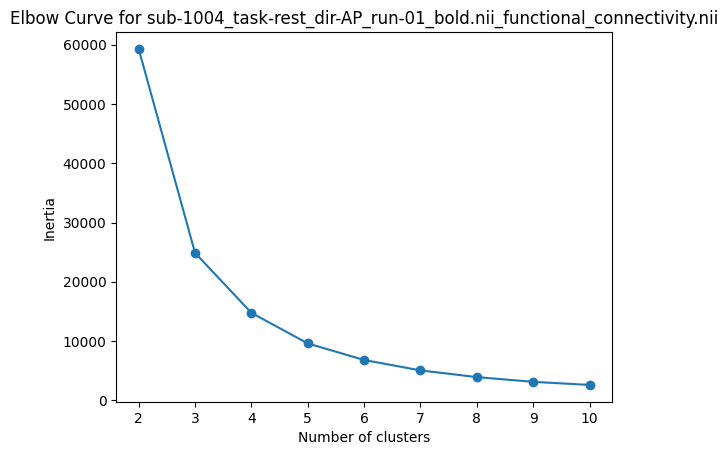

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1532.9931368654713, 0.0)


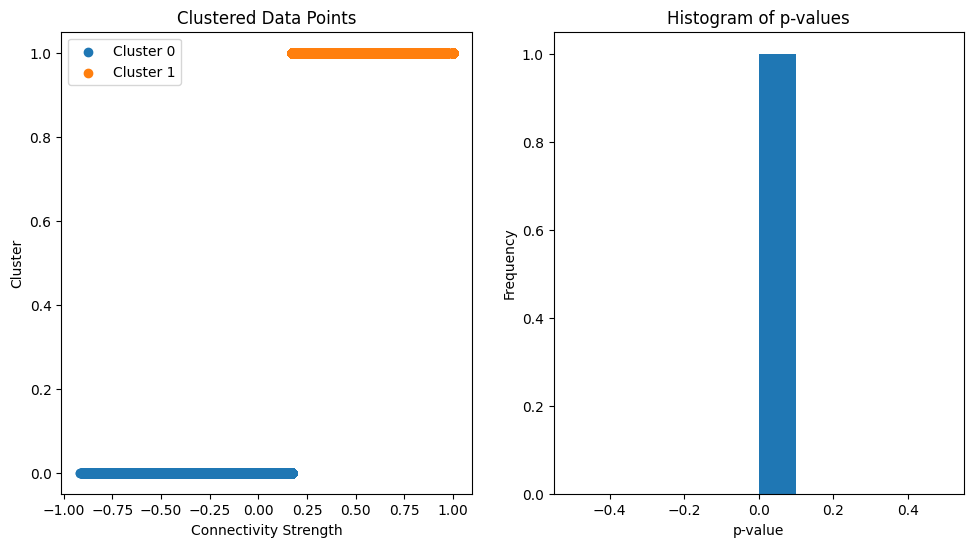

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

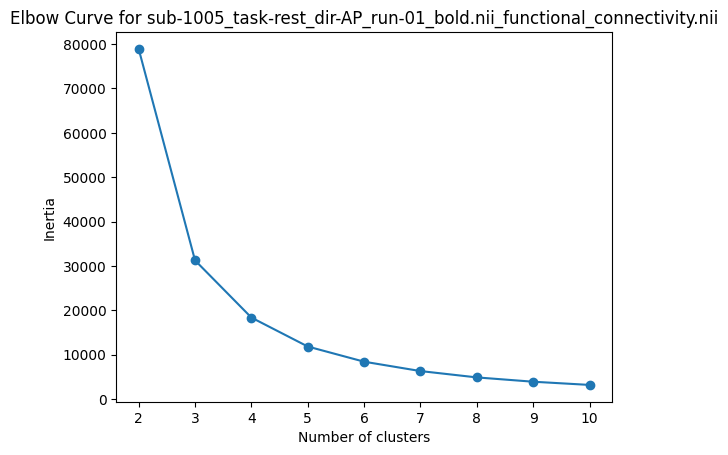

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1578.4782021759634, 0.0)


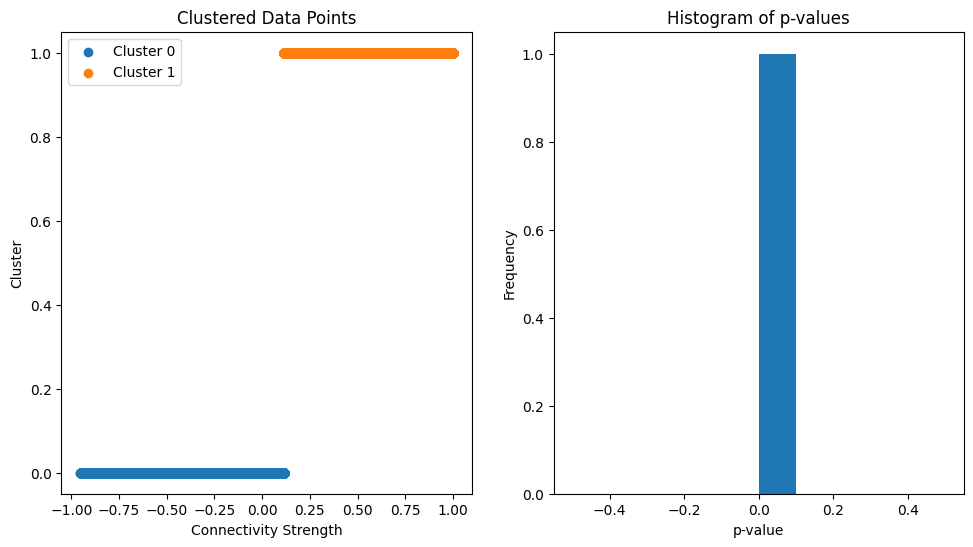

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

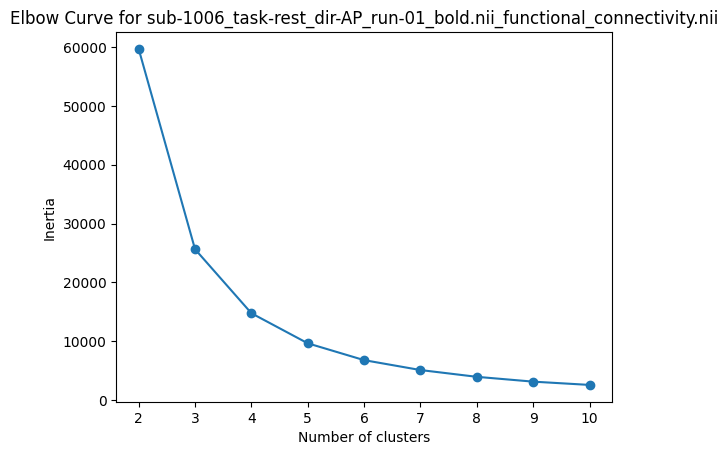

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1421.2198680100578, 0.0)


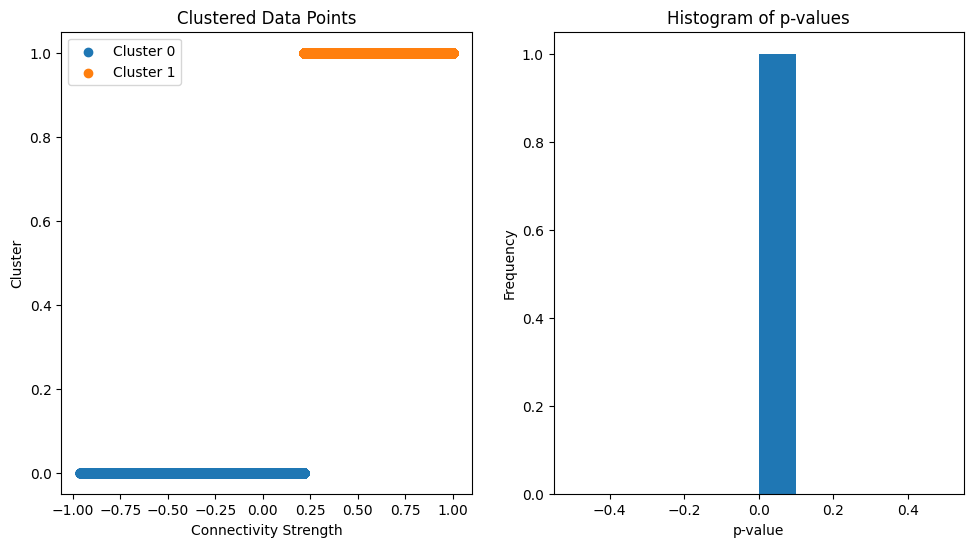

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

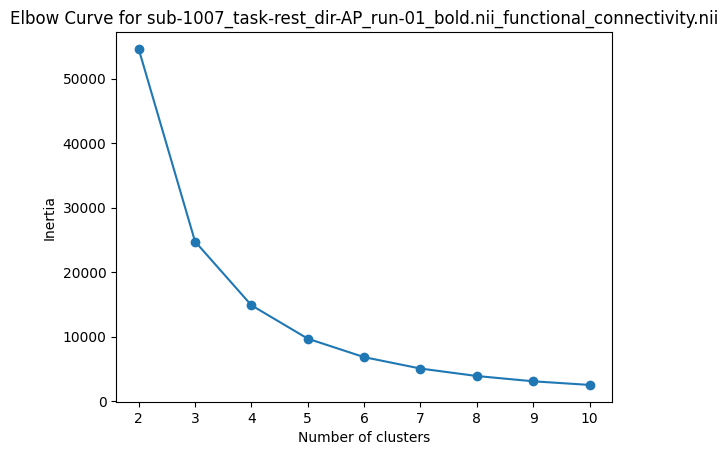

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', 1258.0843365939747, 0.0)


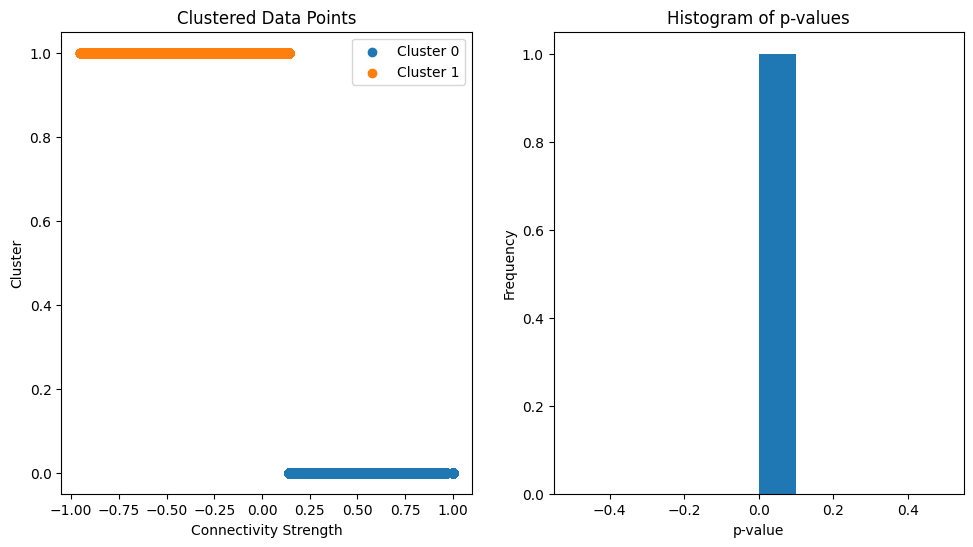

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

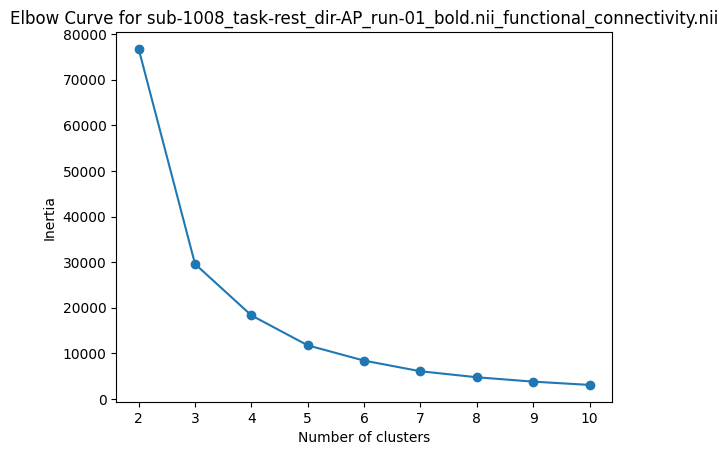

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1610.5683833284384, 0.0)


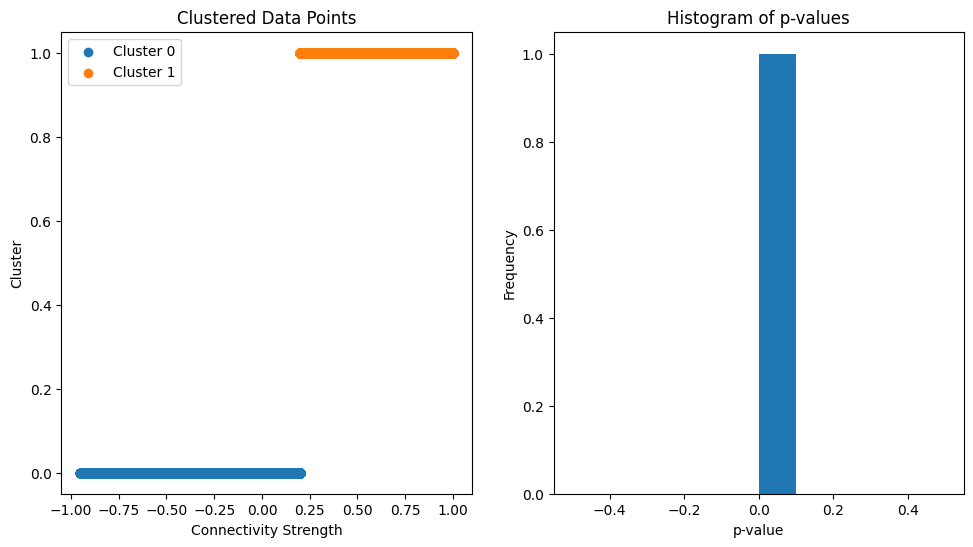

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

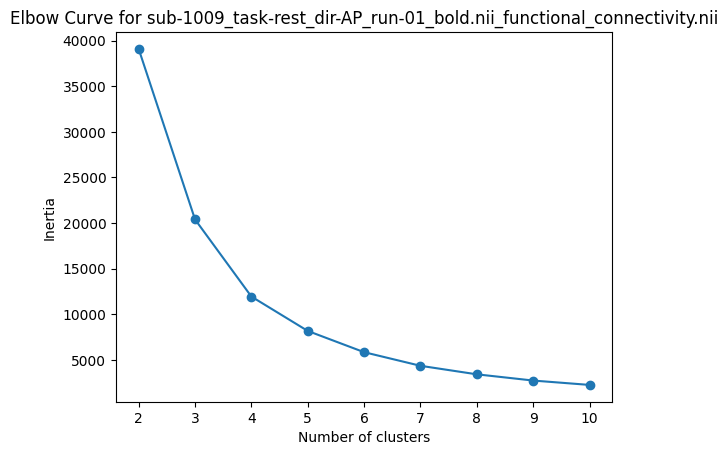

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1676.5329303153922, 0.0)


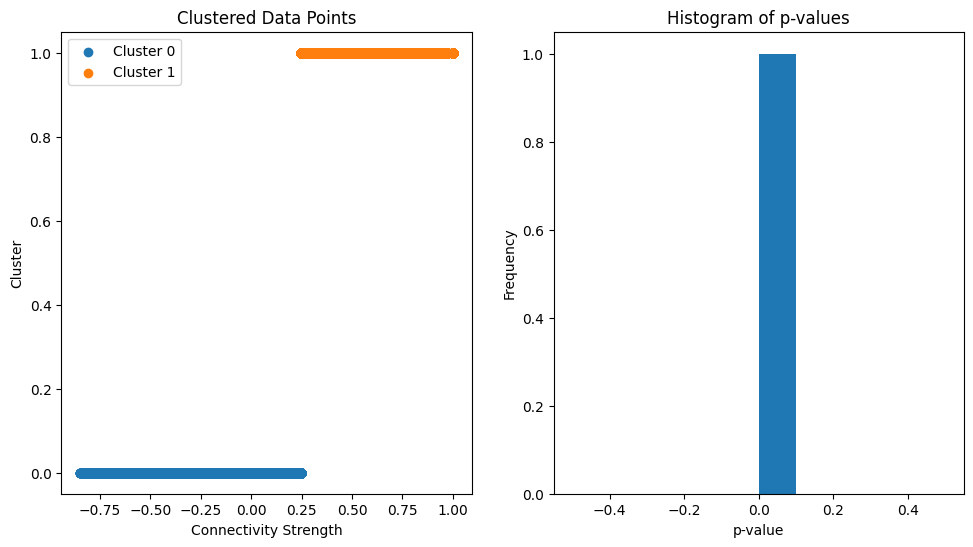

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

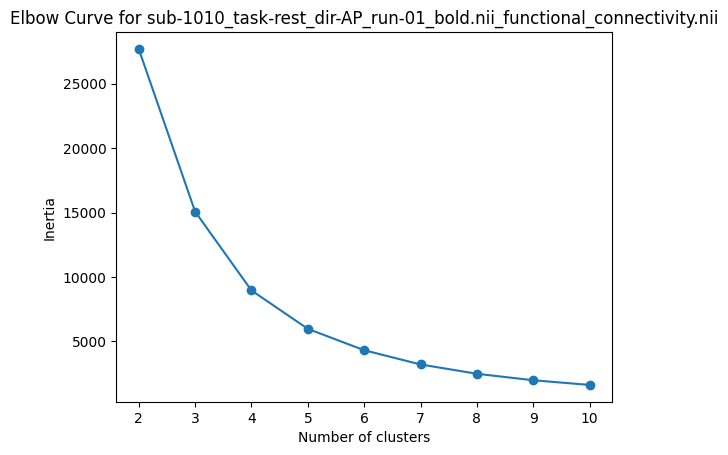

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1350.3471467266863, 0.0)


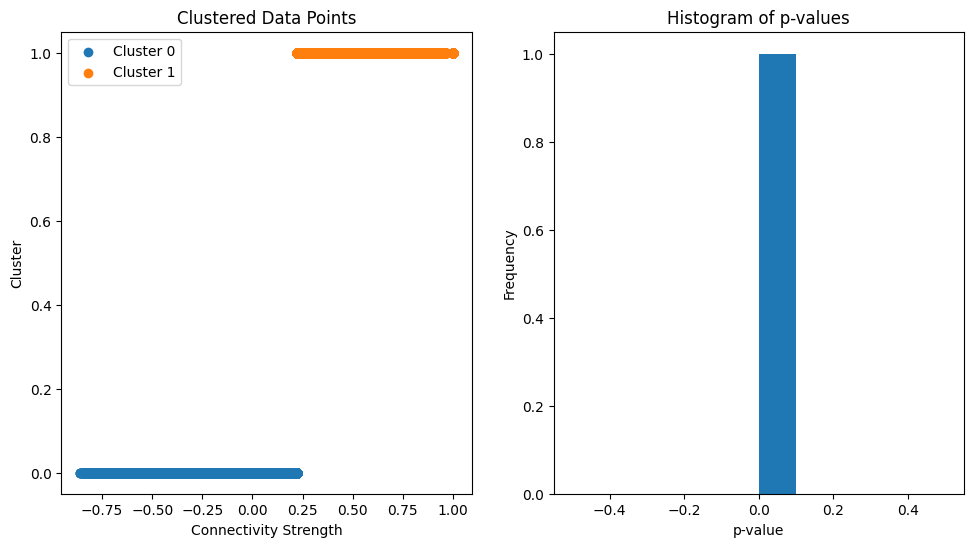

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

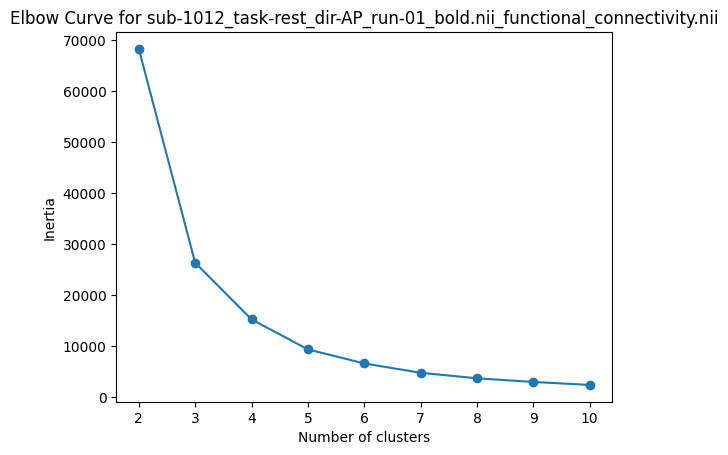

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1241.3965772610436, 0.0)


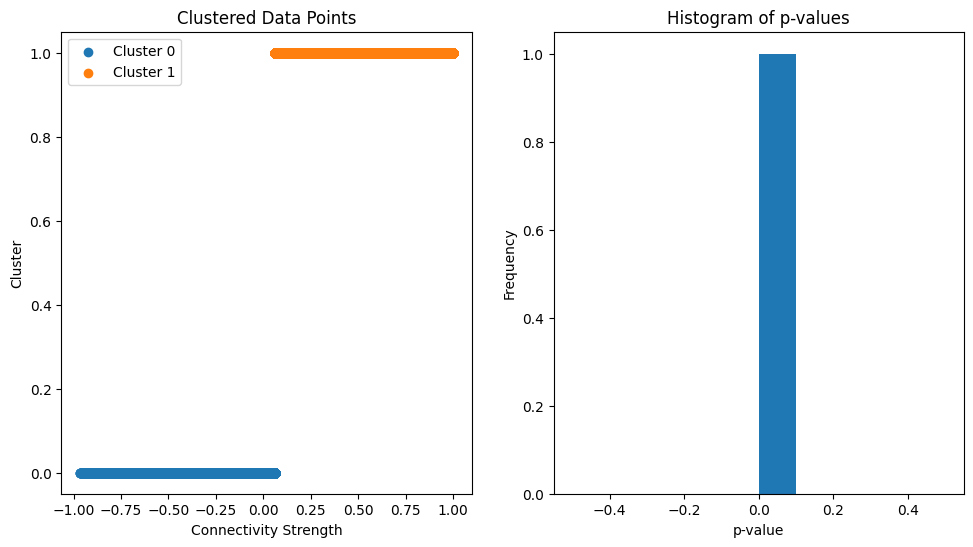

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

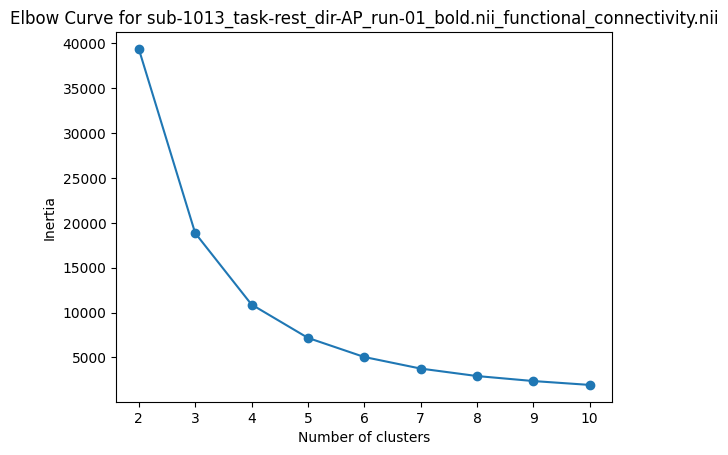

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', 1431.1785025008664, 0.0)


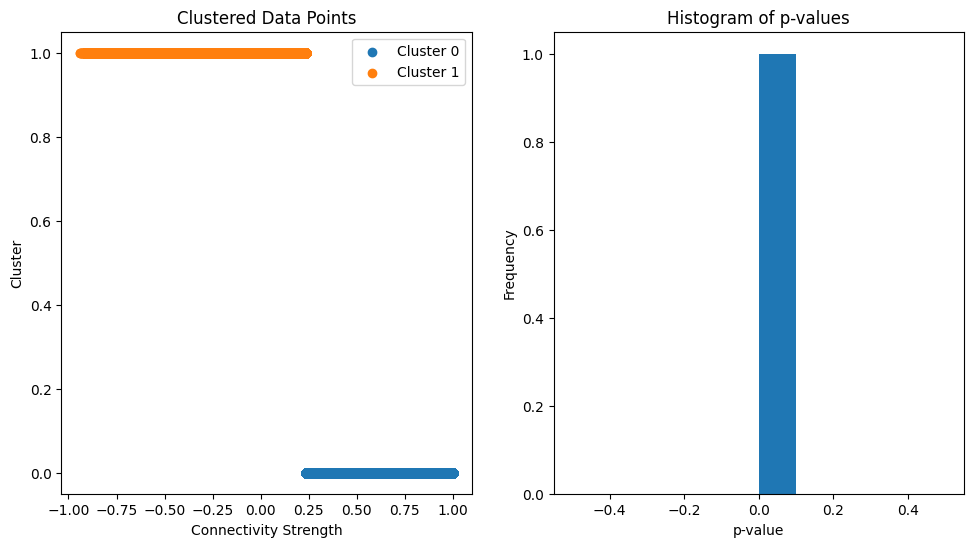

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

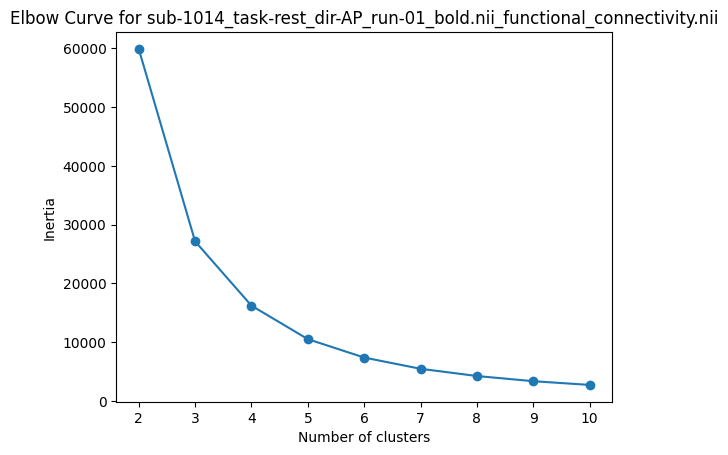

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', 1349.28458753228, 0.0)


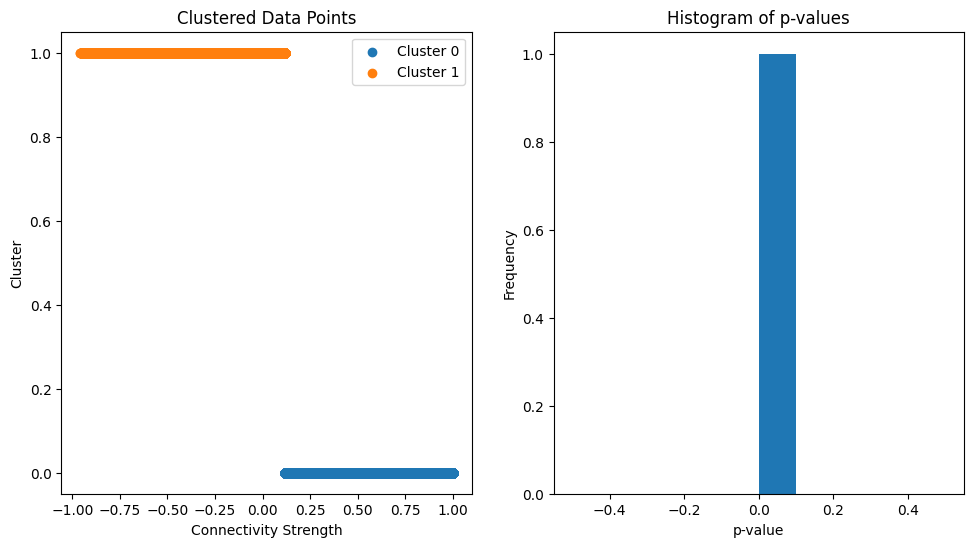

Clustering analysis completed.


In [ ]:
!pip install nilearn
!pip install nibabel
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import ttest_ind
import numpy as np
import os
import nibabel as nib
from nilearn import plotting
import matplotlib.pyplot as plt

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-2'

# Loop through each functional connectivity map
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Reshape the connectivity map to 3D
        connectivity_map = np.expand_dims(connectivity_map, axis=-1)

        # Reshape the connectivity map to 2D
        X = connectivity_map.reshape(-1, connectivity_map.shape[-1])

        # Find the optimal number of clusters using the elbow method
        inertias = []
        max_clusters = 10  # Maximum number of clusters to try
        for n_clusters in range(2, max_clusters + 1):
            kmeans = KMeans(n_clusters=n_clusters, random_state=42)
            kmeans.fit(X)
            inertias.append(kmeans.inertia_)

        # Plot the elbow curve
        plt.figure()
        plt.plot(range(2, max_clusters + 1), inertias, marker='o')
        plt.xlabel('Number of clusters')
        plt.ylabel('Inertia')
        plt.title(f'Elbow Curve for {filename}')
        plt.show()

        # Select the optimal number of clusters based on the elbow method
        optimal_n_clusters = 2  # Default to 2 if the elbow is not clear
        for i in range(1, len(inertias) - 1):
            if inertias[i] < inertias[i - 1] and inertias[i] < inertias[i + 1]:
                optimal_n_clusters = i + 2
                break

        print(f"Best number of clusters: {optimal_n_clusters}")

        # Perform K-means clustering with the optimal number of clusters
        kmeans = KMeans(n_clusters=optimal_n_clusters, random_state=42)
        labels = kmeans.fit_predict(X)

        # Reshape the labels back to the original shape of the connectivity map
        labels_3d = labels.reshape(connectivity_map.shape[:-1])

        # Save the clustered map as a Nifti image
        clustered_map_img = nib.Nifti1Image(labels_3d, affine=nib.load(map_path).affine)
        output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
        nib.save(clustered_map_img, output_filename)

        # Statistical tests
        results = []
        for i in range(optimal_n_clusters):
            for j in range(i + 1, optimal_n_clusters):
                cluster1 = connectivity_map[labels_3d == i]
                cluster2 = connectivity_map[labels_3d == j]
                t_stat, p_val = ttest_ind(cluster1.flatten(), cluster2.flatten())
                results.append((f"Cluster {i} vs. Cluster {j}", t_stat, p_val))

        # Print or store the results for further analysis
        for result in results:
            print(result)

        # Plotting the results
        p_values = [result[2] for result in results]
        t_stats = [result[1] for result in results]

        plt.figure(figsize=(18, 6))

        # Scatter plot of the clustered data points
        plt.subplot(1, 3, 1)
        for i in range(optimal_n_clusters):
            cluster_data = connectivity_map[labels_3d == i].reshape(-1)
            plt.scatter(cluster_data, np.ones_like(cluster_data)*i, label=f'Cluster {i}')
        plt.xlabel('Connectivity Strength')
        plt.ylabel('Cluster')
        plt.title('Clustered Data Points')
        plt.legend()

        # Histogram of p-values
        plt.subplot(1, 3, 2)
        plt.hist(p_values, bins=10)
        plt.xlabel('p-value')
        plt.ylabel('Frequency')
        plt.title('Histogram of p-values')

        # Save the plot
        plot_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_results.png")
        plt.savefig(plot_filename)

        plt.show()

print("Clustering analysis completed.")


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

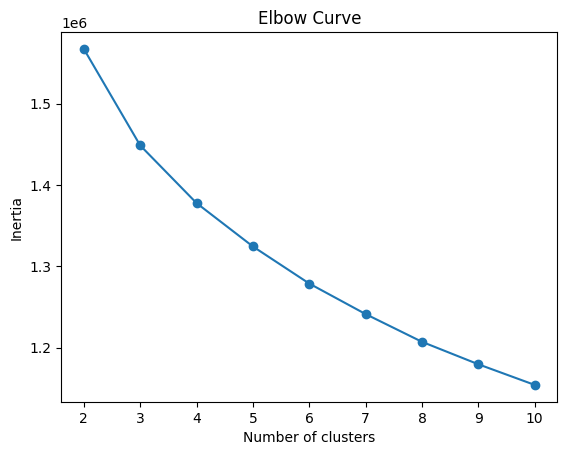

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Cluster 0 indices out of bounds. Skipping.
Cluster 1 indices out of bounds. Skipping.


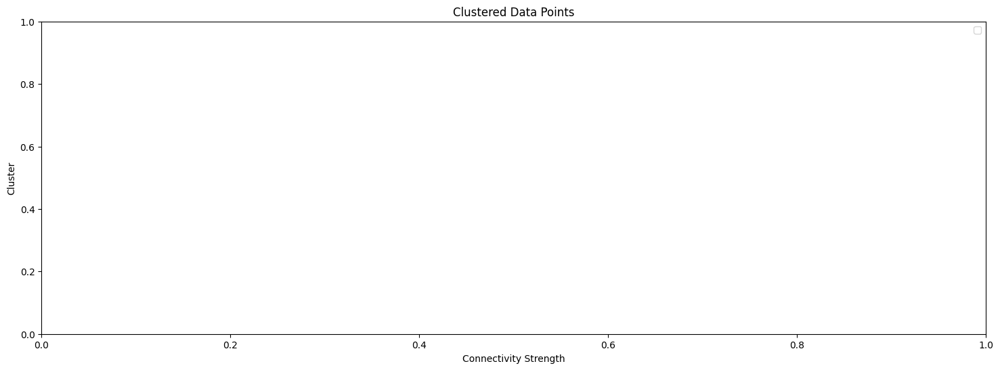

In [ ]:
!pip install nilearn
!pip install nibabel
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import ttest_ind
import numpy as np
import os
import nibabel as nib
from nilearn import plotting
import matplotlib.pyplot as plt

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-2'

# Create a list to store all connectivity maps
all_maps = []

# Loop through each functional connectivity map
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Reshape the connectivity map to 3D
        connectivity_map = np.expand_dims(connectivity_map, axis=-1)

        # Reshape the connectivity map to 2D
        X = connectivity_map.reshape(-1, connectivity_map.shape[-1])

        # Append the connectivity map to the list
        all_maps.append(X)

# Get the maximum shape among all maps
max_map_shape = max(map_data.shape for map_data in all_maps)

# Resize all maps to the maximum shape
resized_maps = [np.pad(map_data, ((0, max_map_shape[0] - map_data.shape[0]), (0, 0)), mode='constant') for map_data in all_maps]

# Concatenate all connectivity maps along the last axis
all_maps_concatenated = np.concatenate(resized_maps, axis=-1)

# Find the optimal number of clusters using the elbow method
inertias = []
max_clusters = 10  # Maximum number of clusters to try
for n_clusters in range(2, max_clusters + 1):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(all_maps_concatenated)
    inertias.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure()
plt.plot(range(2, max_clusters + 1), inertias, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Curve')
plt.show()

# Select the optimal number of clusters based on the elbow method
optimal_n_clusters = 2  # Default to 2 if the elbow is not clear
for i in range(1, len(inertias) - 1):
    if inertias[i] < inertias[i - 1] and inertias[i] < inertias[i + 1]:
        optimal_n_clusters = i + 2
        break

print(f"Best number of clusters: {optimal_n_clusters}")

# Perform K-means clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_n_clusters, random_state=42)
labels = kmeans.fit_predict(all_maps_concatenated)

plt.figure(figsize=(18, 6))
for i in range(optimal_n_clusters):
    # Get the indices where labels match i
    cluster_indices = np.where(labels == i)[0]

    # Check if any cluster indices are out of bounds
    if np.any(cluster_indices >= all_maps_concatenated.shape[1]):
        print(f"Cluster {i} indices out of bounds. Skipping.")
        continue

    # Flatten and concatenate the corresponding columns
    cluster_data = all_maps_concatenated[:, cluster_indices].flatten()

    # Plot the clustered data
    plt.scatter(cluster_data, np.ones_like(cluster_data)*i, label=f'Cluster {i}')

plt.xlabel('Connectivity Strength')
plt.ylabel('Cluster')
plt.title('Clustered Data Points')
plt.legend()
plt.show()



Cluster 0 indices out of bounds or empty. Skipping.
Cluster 1 indices out of bounds or empty. Skipping.


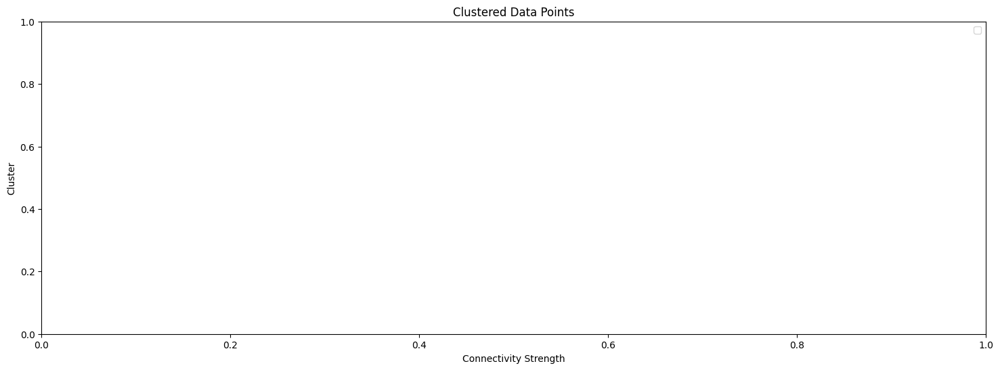

In [ ]:
plt.figure(figsize=(18, 6))
for i in range(optimal_n_clusters):
    # Get the indices where labels match i
    cluster_indices = np.where(labels == i)[0]

    # Check if any cluster indices are out of bounds or if there are no points in the cluster
    if np.any(cluster_indices >= all_maps_concatenated.shape[1]) or len(cluster_indices) == 0:
        print(f"Cluster {i} indices out of bounds or empty. Skipping.")
        continue
    print(f"Cluster {i} indices:", cluster_indices)
    print("Shape of all_maps_concatenated:", all_maps_concatenated.shape)

    # Flatten and concatenate the corresponding columns
    cluster_data = all_maps_concatenated[:, cluster_indices].flatten()

    # Plot the clustered data with label
    plt.scatter(cluster_data, np.ones_like(cluster_data)*i, label=f'Cluster {i}')

plt.xlabel('Connectivity Strength')
plt.ylabel('Cluster')
plt.title('Clustered Data Points')
plt.legend()
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1532.9931368654713, 0.0)


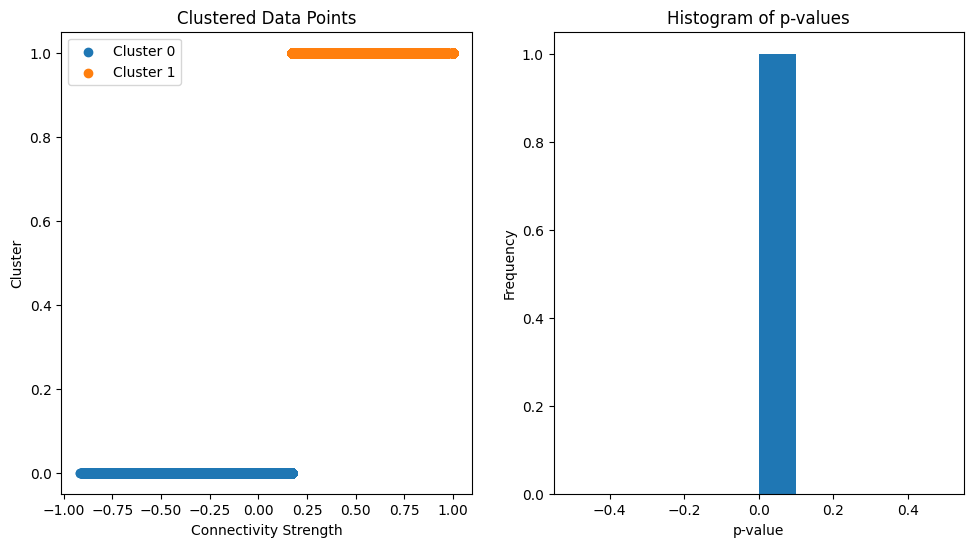

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1578.4782021759634, 0.0)


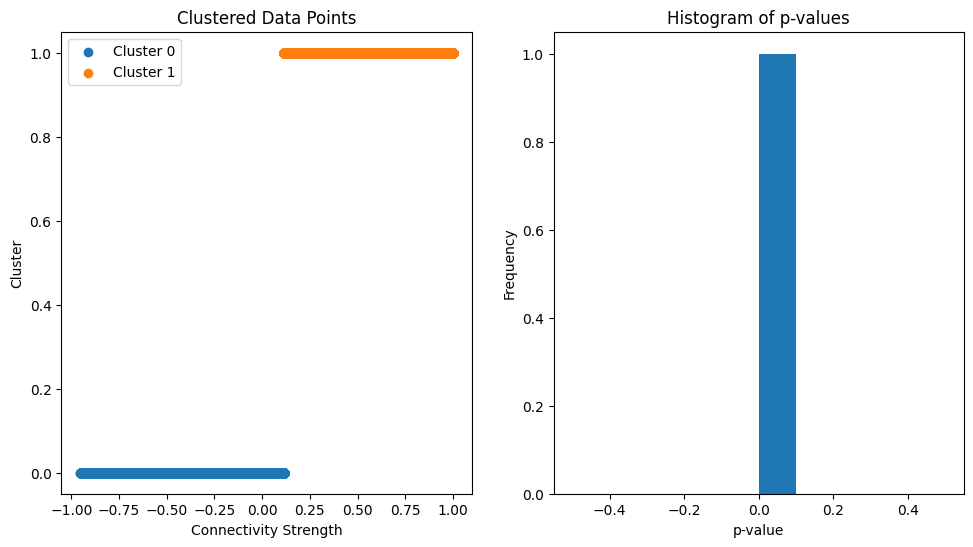

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1421.2198680100578, 0.0)


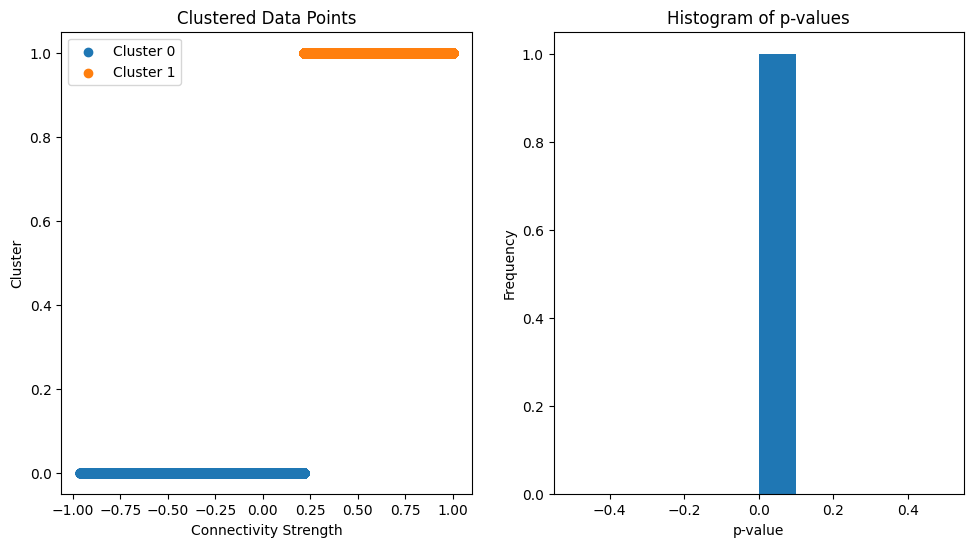

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', 1258.0843365939747, 0.0)


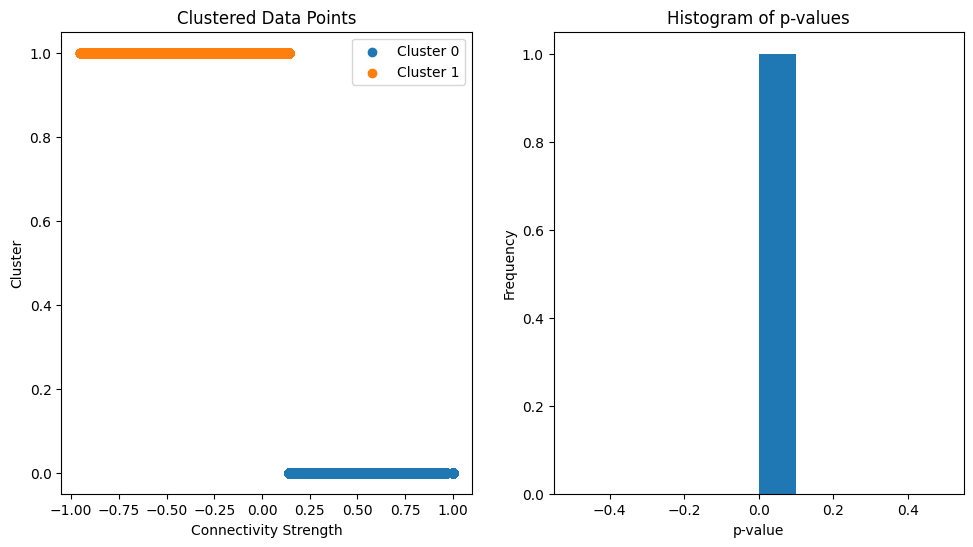

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1610.5683833284384, 0.0)


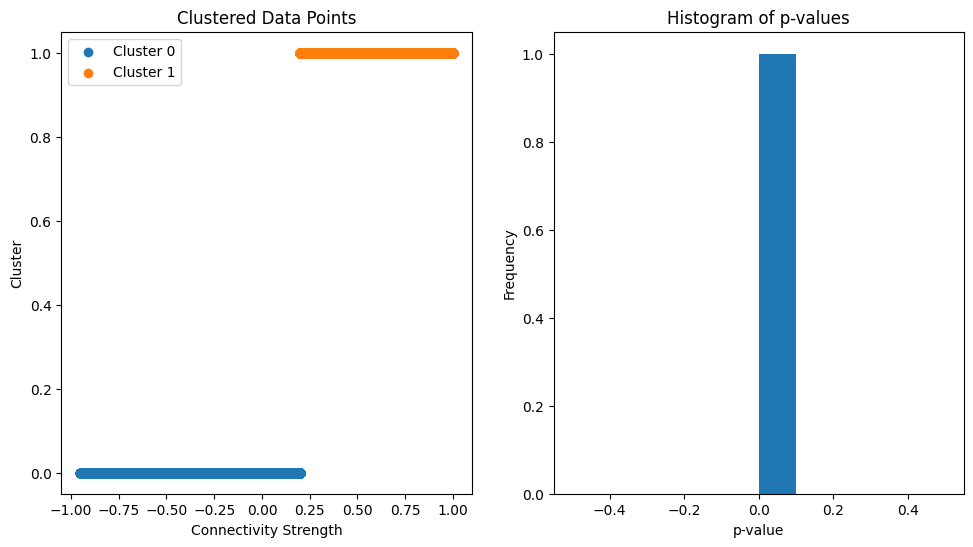

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1676.5329303153922, 0.0)


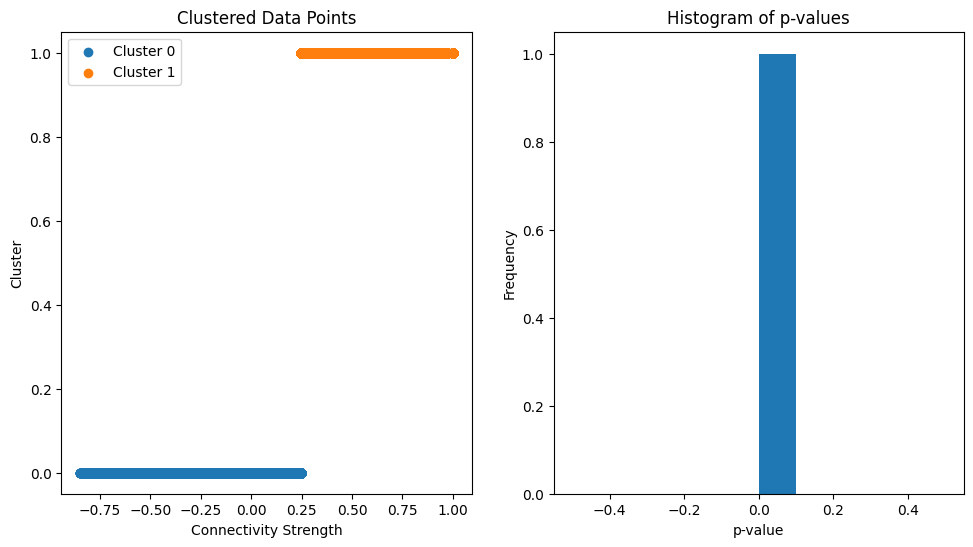

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1350.3471467266863, 0.0)


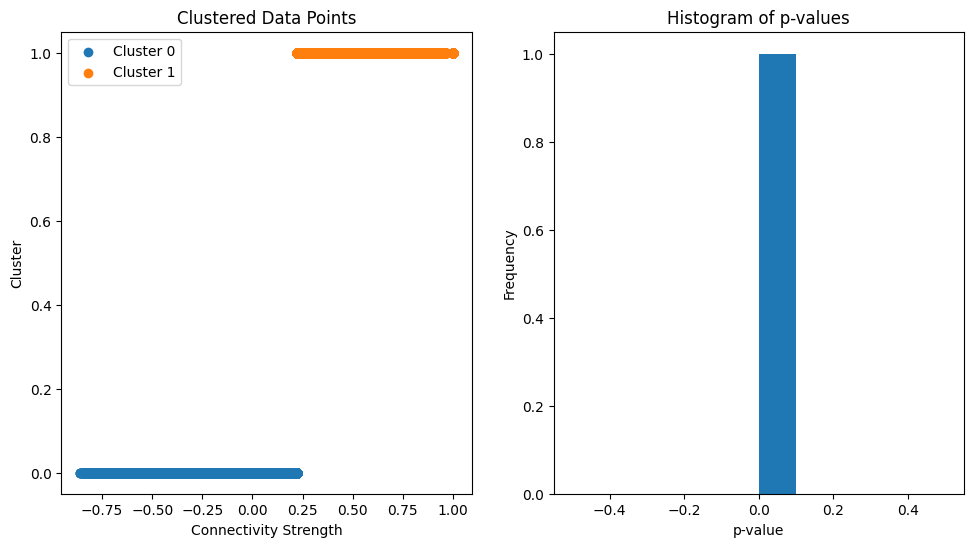

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', -1241.3965772610436, 0.0)


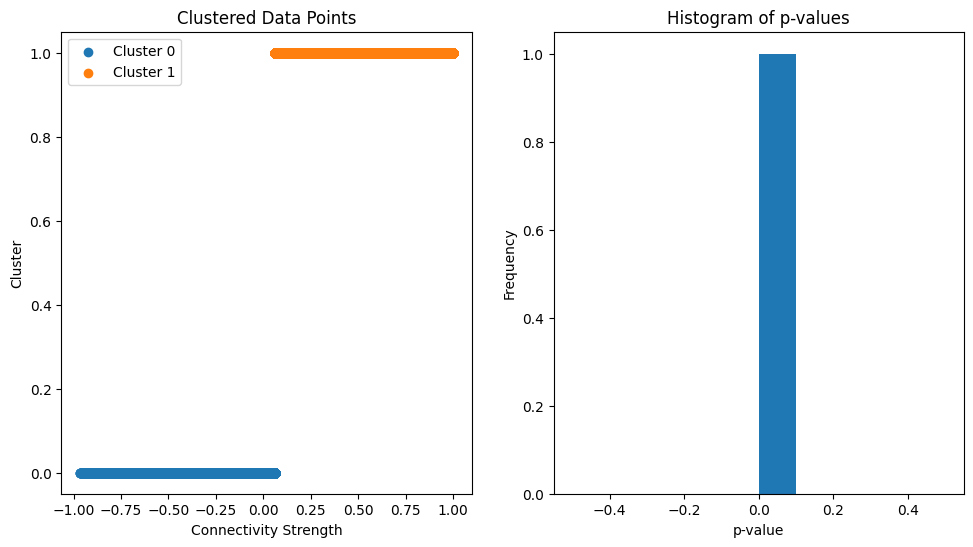

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', 1431.1785025008664, 0.0)


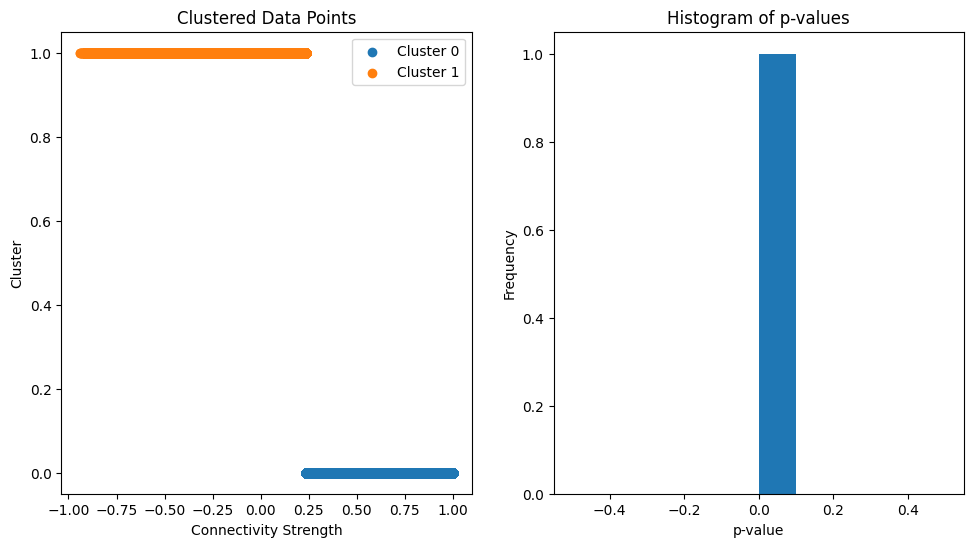

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Best number of clusters: 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


('Cluster 0 vs. Cluster 1', 1349.28458753228, 0.0)


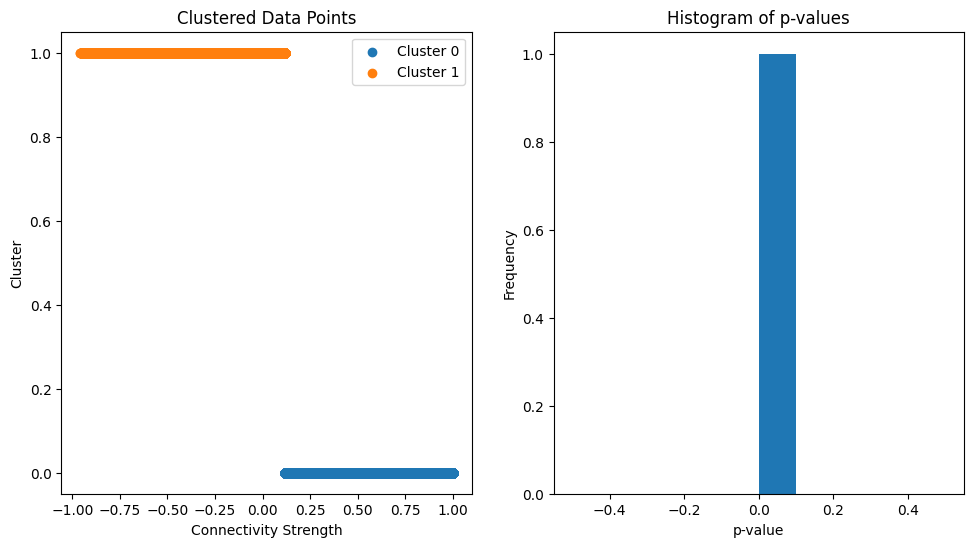

Clustering analysis completed.


In [ ]:
!pip install nilearn
!pip install nibabel
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import ttest_ind
import numpy as np
import os
import nibabel as nib
from nilearn import plotting
import matplotlib.pyplot as plt

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-2'

# Loop through each functional connectivity map


# Loop through each functional connectivity map
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Reshape the connectivity map to 3D
        connectivity_map = np.expand_dims(connectivity_map, axis=-1)

        # Reshape the connectivity map to 2D
        X = connectivity_map.reshape(-1, connectivity_map.shape[-1])

        # Find the optimal number of clusters using the elbow method
        inertias = []
        max_clusters = 10  # Maximum number of clusters to try
        for n_clusters in range(2, max_clusters + 1):
            kmeans = KMeans(n_clusters=n_clusters, random_state=42)
            kmeans.fit(X)
            inertias.append(kmeans.inertia_)

        # Select the optimal number of clusters based on the elbow method
        optimal_n_clusters = 2  # Default to 2 if the elbow is not clear
        for i in range(1, len(inertias) - 1):
            if inertias[i] < inertias[i - 1] and inertias[i] < inertias[i + 1]:
                optimal_n_clusters = i + 2
                break

        print(f"Best number of clusters: {optimal_n_clusters}")

        # Perform K-means clustering with the optimal number of clusters
        kmeans = KMeans(n_clusters=optimal_n_clusters, random_state=42)
        labels = kmeans.fit_predict(X)

        # Reshape the labels back to the original shape of the connectivity map
        labels_3d = labels.reshape(connectivity_map.shape[:-1])

        # Save the clustered map as a Nifti image
        clustered_map_img = nib.Nifti1Image(labels_3d, affine=nib.load(map_path).affine)
        output_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_clustered.nii.gz")
        nib.save(clustered_map_img, output_filename)

        # Perform statistical tests
        results = []
        for i in range(optimal_n_clusters):
            for j in range(i + 1, optimal_n_clusters):
                cluster1 = connectivity_map[labels_3d == i]
                cluster2 = connectivity_map[labels_3d == j]
                t_stat, p_val = ttest_ind(cluster1.flatten(), cluster2.flatten())
                results.append((f"Cluster {i} vs. Cluster {j}", t_stat, p_val))
        for result in results:
            print(result)

        # Plotting the results
        p_values = [result[2] for result in results]
        t_stats = [result[1] for result in results]

        plt.figure(figsize=(18, 6))

        # Scatter plot of the clustered data points
        plt.subplot(1, 3, 1)
        for i in range(optimal_n_clusters):
            cluster_data = connectivity_map[labels_3d == i].reshape(-1)
            plt.scatter(cluster_data, np.ones_like(cluster_data)*i, label=f'Cluster {i}')
        plt.xlabel('Connectivity Strength')
        plt.ylabel('Cluster')
        plt.title('Clustered Data Points')
        plt.legend()

        # Histogram of p-values
        plt.subplot(1, 3, 2)
        plt.hist(p_values, bins=10)
        plt.xlabel('p-value')
        plt.ylabel('Frequency')
        plt.title('Histogram of p-values')

        # Save the plot
        plot_filename = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_results.png")
        plt.savefig(plot_filename)

        plt.show()

print("Clustering analysis completed.")


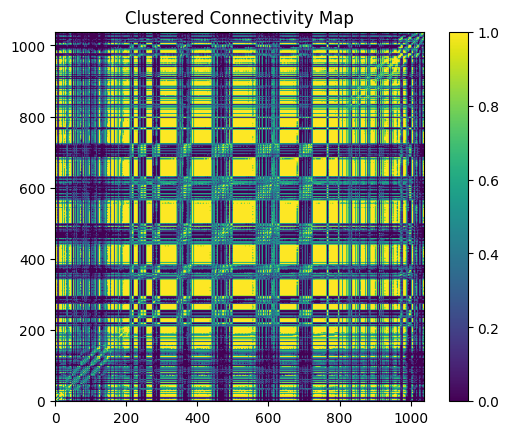

In [ ]:
# Load the clustered map
clustered_map_path = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-2/sub-1004_task-rest_dir-AP_run-01_bold.nii_functional_connectivity_clustered.nii.gz'  # Path to the clustered map NIfTI image
# Load the clustered map
#clustered_map_path = output_filename  # Path to the clustered map NIfTI image
clustered_map_img = nib.load(clustered_map_path).get_fdata()

# Plot the clustered map
plt.imshow(clustered_map_img, cmap='viridis', origin='lower')
plt.colorbar()
plt.title('Clustered Connectivity Map')
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Clustering analysis completed.


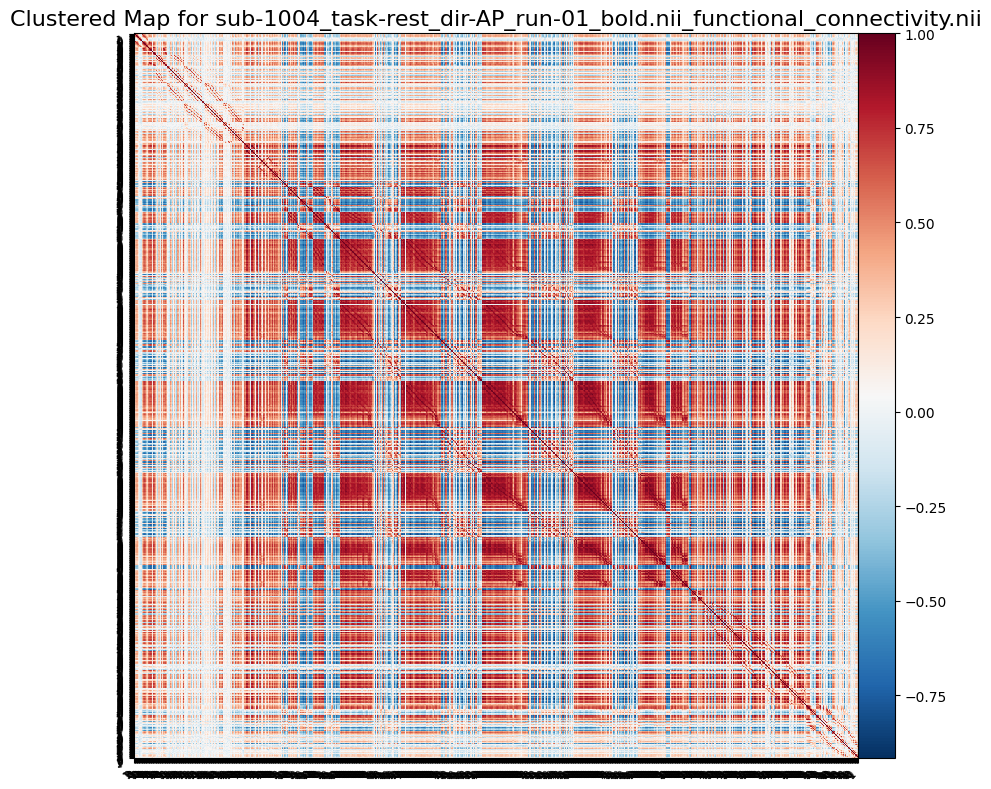

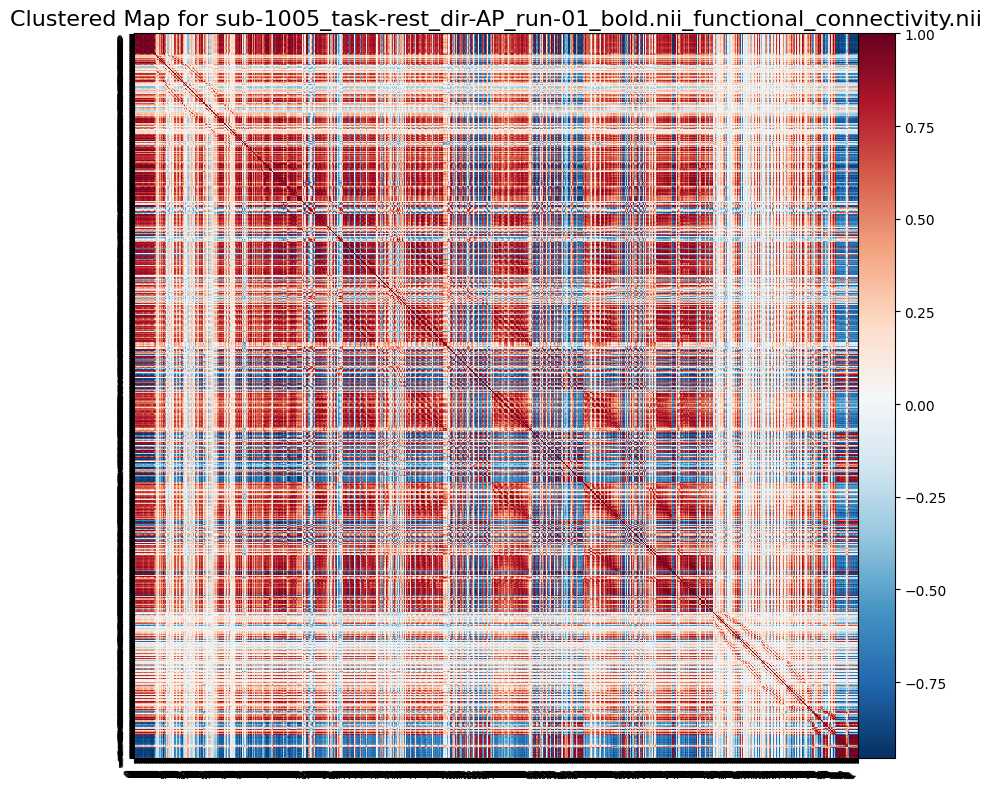

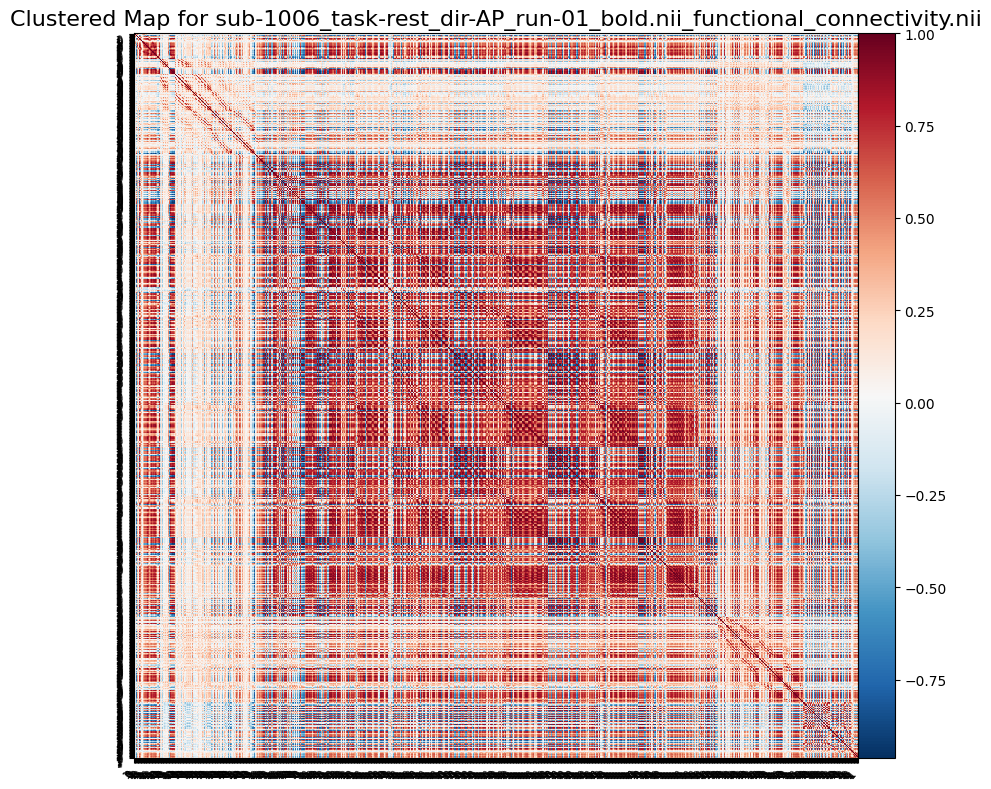

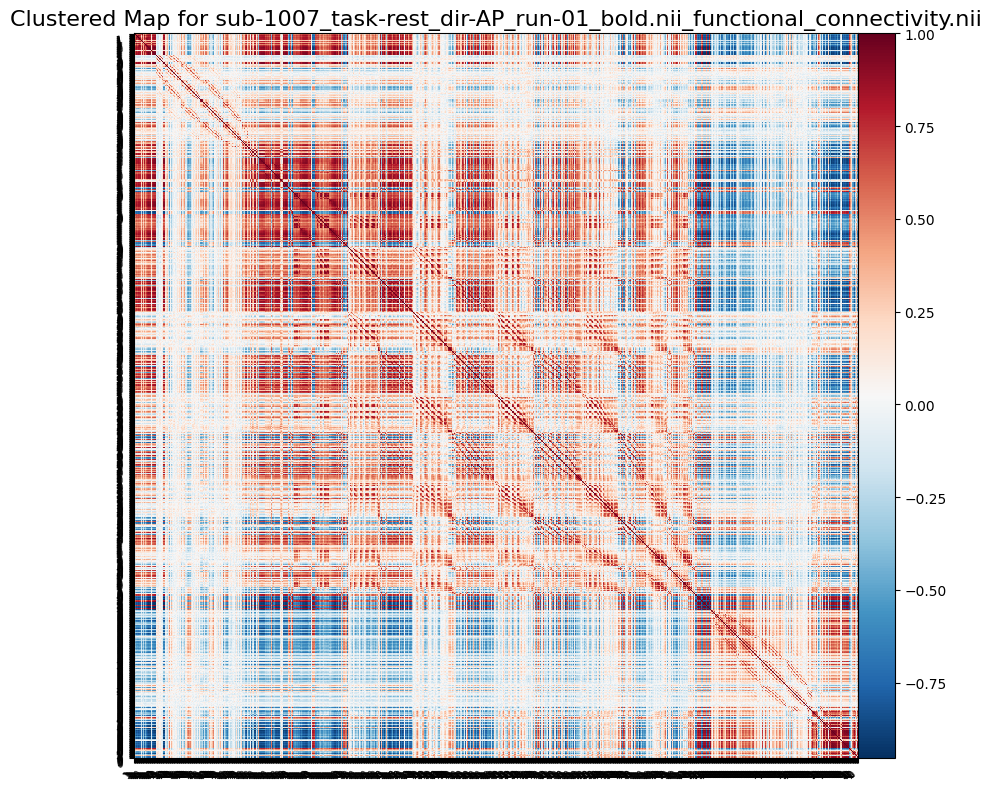

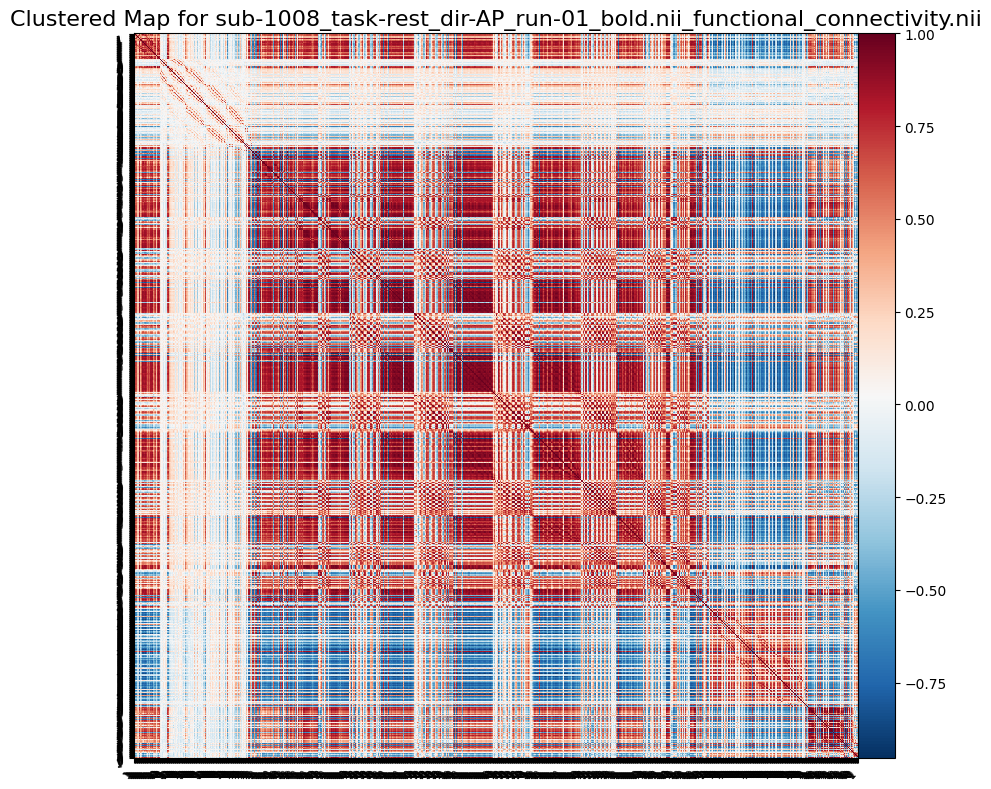

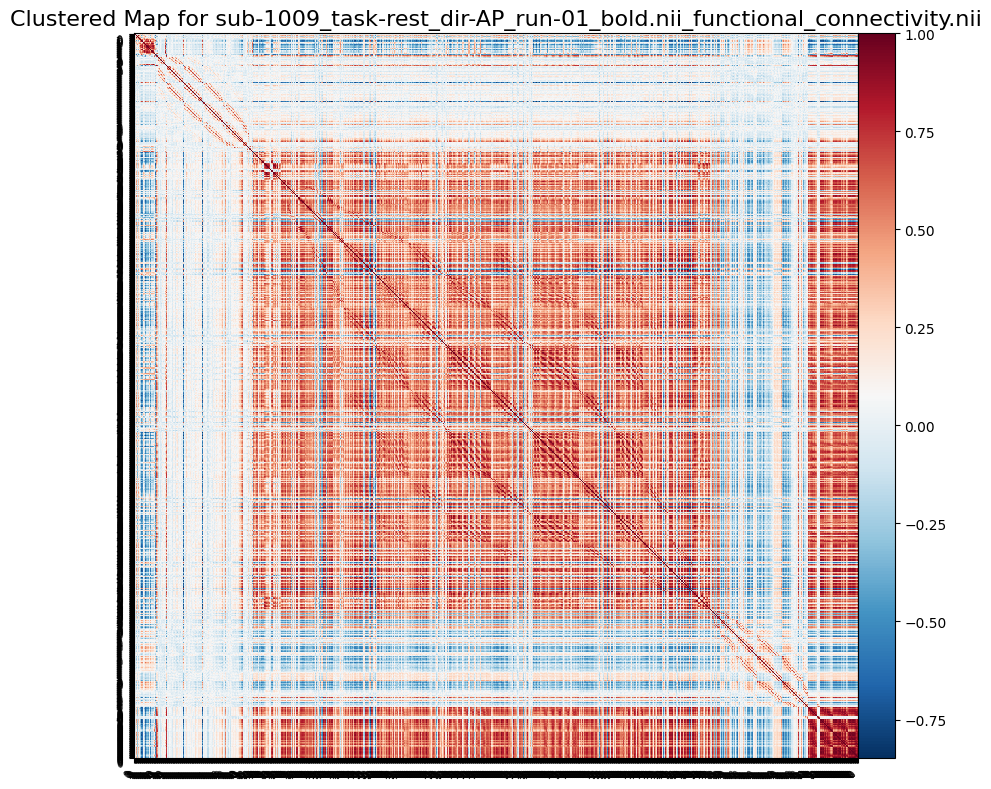

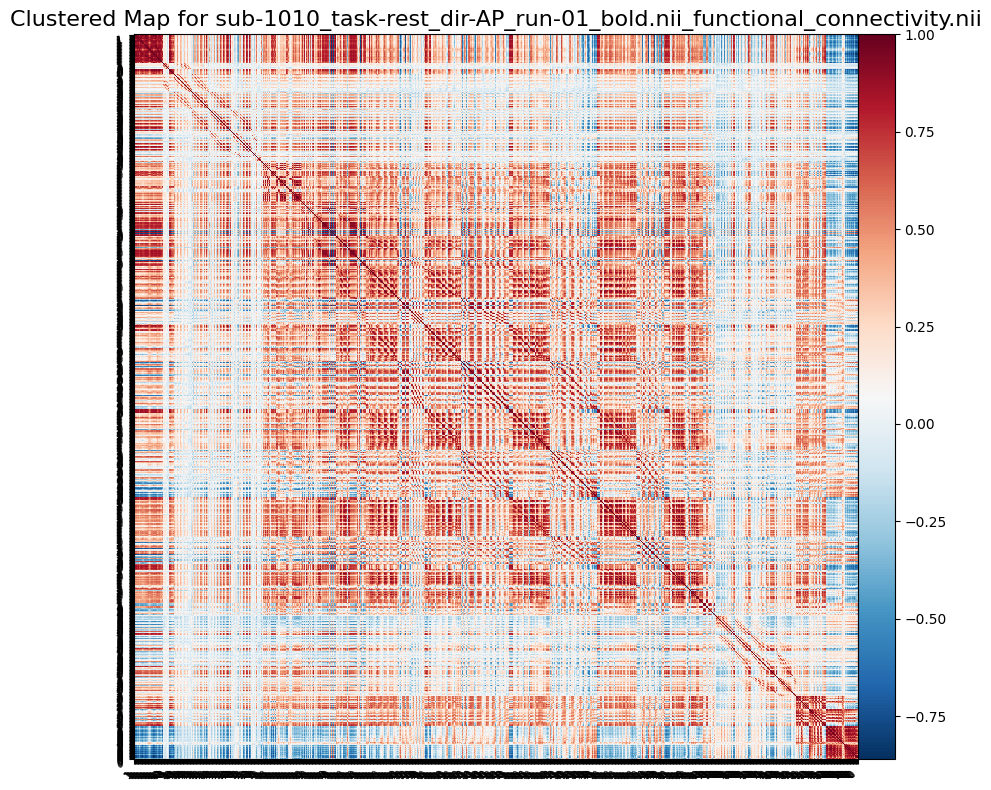

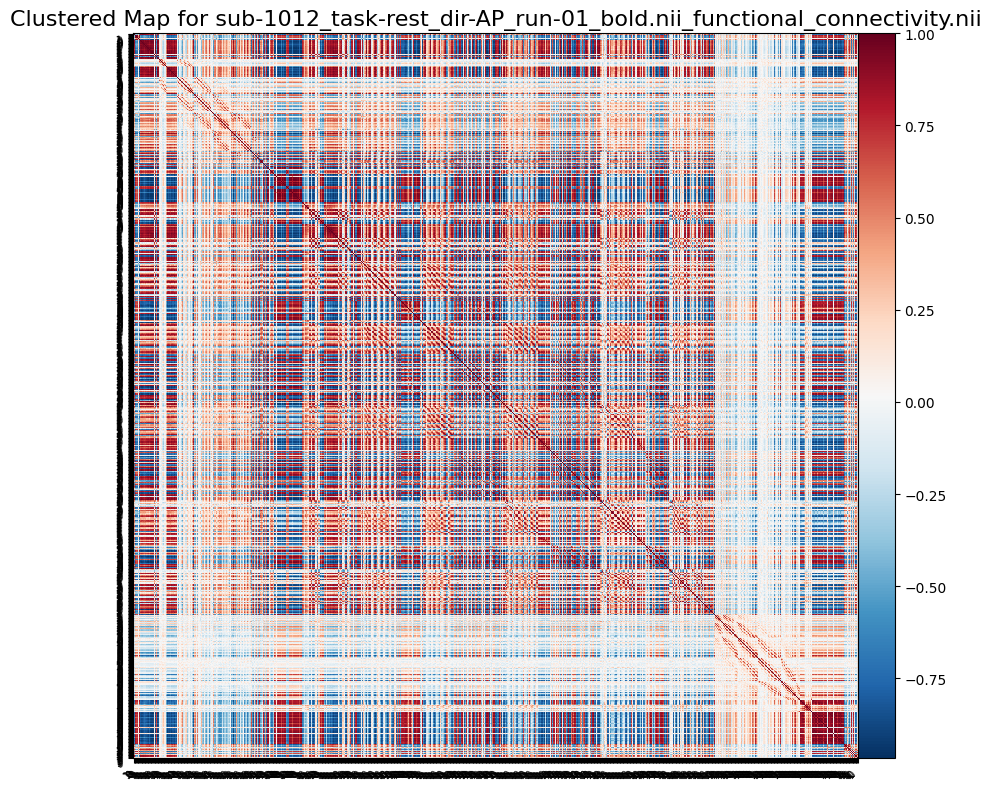

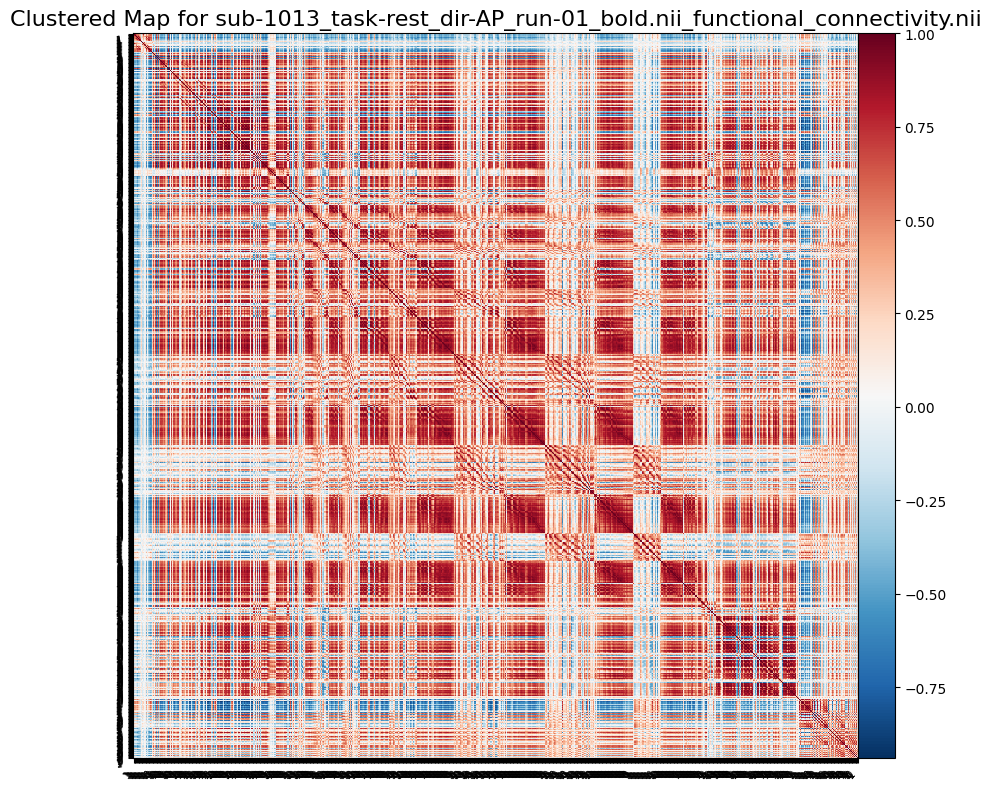

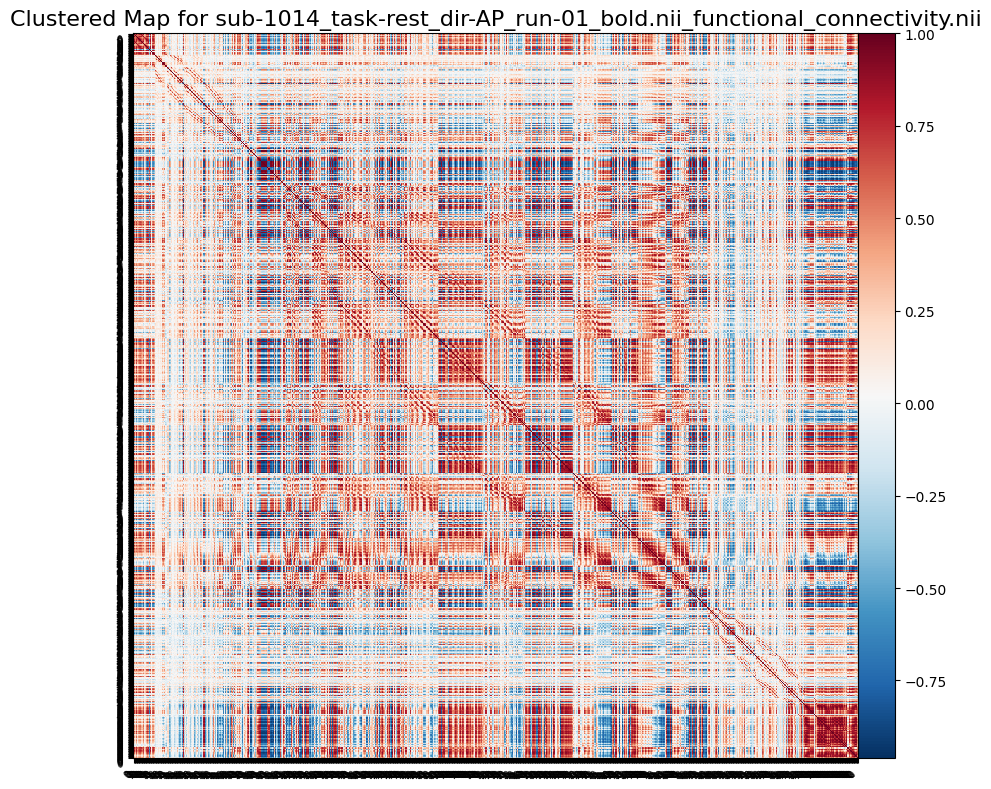

In [ ]:
!pip install nilearn
from sklearn.cluster import KMeans
import numpy as np
import os
import nibabel as nib
from nilearn import plotting

# Directory containing functional connectivity maps (.nii format)
maps_folder = '/content/drive/MyDrive/CLPS1490-FINAL PROJ RESULTS'

# Directory to save the clustering results
output_dir = '/content/drive/MyDrive/CLPS-1490-FINAL PROJ RESULTS-1'

# Loop through each functional connectivity map
for filename in os.listdir(maps_folder):
    if filename.endswith('.nii'):
        map_path = os.path.join(maps_folder, filename)

        # Load the functional connectivity map
        connectivity_map = nib.load(map_path).get_fdata()

        # Reshape the connectivity map to 2D
        connectivity_map_2d = connectivity_map.reshape(-1, connectivity_map.shape[-1])

        # Perform K-means clustering with 2 clusters
        kmeans = KMeans(n_clusters=2, random_state=42)
        labels = kmeans.fit_predict(connectivity_map_2d)

        # Reshape the labels back to the original shape of the connectivity map
        labels_3d = labels.reshape(connectivity_map.shape[:-1])

        # Plot the clustered map
        plotting.plot_matrix(connectivity_map, figure=(10, 8), labels=labels_3d, title=f"Clustered Map for {filename}")

print("Clustering analysis completed.")
